# Visión por Computador - Práctica 3 - Extracción (y Emparejamiento) de Características y Registrado de Imágenes

#### 11 puntos   |   Fecha de entrega: 31 de Diciembre, 23:59   |   Forma de entrega: a través de la tarea creada en https://pradogrado2425.ugr.es/

### Estudiante: <mark>PABLO GÁLVEZ ORTIGOSA</mark>



<font color='blue'>En esta práctica aprenderás:

<font color='blue'>a) A detectar puntos de interés utilizando el detector de esquinas de Harris (Ejercicio 1).

<font color='blue'>b) A encontrar correspondencias entre los _keypoints_ (puntos de interés) de dos imágenes utilizando distintos descriptores (Ejercicio 2).

<font color='blue'>c) A componer un mosaico/panorama a partir de un conjunto de imágenes utilizando homografías (Ejercicio 3).

In [ ]:
# Let's start importing all background modules
# We start by getting access to the drive
from google.colab import drive
drive.mount('/content/drive', force_remount=True)
import sys,os
# change directory
%cd '/content/drive/My Drive'
# Let's import the python module exercises.py  to have access to its functions and Classes
get_image = lambda route: os.path.join('/content/drive/MyDrive/images/', route)
import numpy as np
from matplotlib import pyplot as plt
import cv2

Mounted at /content/drive
/content/drive/My Drive


In [ ]:
'''
This function receives a string with the filename of the image to read,
and a flag indicating if we want to read it in color/RGB (flagColor=1) or gray level (flagColor=0)

Example of use:
im1=readIm(get_image('apple.jpg'),0)

'''
def readIm(filename, flagColor=1):
  # cv2 reads BGR format
  im=cv2.imread(filename)
  # change to  RGB and return the image
  if(flagColor):
    return cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
  # change from BGR to grayscale instead if flag is 0
  return cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)

In [ ]:
'''
This function receives an array of arbitrary real numbers (that could include even negative values),
and returns an 'image' in the range [0,1].
flag_GLOBAL allows the user to normalize the whole image (including all channels) or to normalize
each channel/band independently.
'''
def rangeDisplay01(im, flag_GLOBAL= True):
  im = im.astype(float)
  if flag_GLOBAL:
    im = (im - im.min())/(im.max() - im.min())
  else:
    # bands normalization
    for band in range(im.shape[2]):
      im[:, :, band] = (im[:, :, band] - im[:, :, band].min())/(im[:, :, band].max() - im[:, :, band].min())
      # Note: remember that, for plt.imshow with RGB data, the valid range is [0..1] for floats and [0..255] for integers.
  return im

In [ ]:
'''
This function displays a single image, including a title, using a magnification factor.

Example of use:
im1=readIm(get_image('apple.jpg'),0)
displayIm(im1,'Manzana',0.5)

'''
def displayIm(im, title='Result',factor= 2):
  # First normalize range
  max=np.max(im)
  min=np.min(im)
  if min<0 or max>255:
    im=rangeDisplay01(im,flag_GLOBAL=True)
  if len(im.shape) == 3:
    # im es tribanda
    plt.imshow(im, cmap='jet')
  else:
    # im es monobanda
    plt.imshow(im, cmap='gray')
  figure_size = plt.gcf().get_size_inches()
  plt.gcf().set_size_inches(factor * figure_size)
  plt.title(title)
  plt.xticks([]), plt.yticks([]) # eliminamos numeración
  plt.show()

In [ ]:
'''
This function displays multiple images (including a title and using a magnification factor)
of equal size. The input to the function is a list of images.

Example of use:
im1=readIm(get_image('apple.jpg'),1)
images = [im1,im1,im1]

displayMI_ES(images, title='Manzanas',factor=1)

'''
def displayMI_ES(vim, title='Result',factor=2):
  # We set the maximun number of images to concatenate by columns
  maxcolumns=3
  # number of images to display
  numberim=len(vim)
  # The simplest case, one row: the maximum number of columns is larger than the images to stack
  # This is, by default, we put together the images column-wise
  if len(vim) < maxcolumns:
    out=vim[0]
    for item in range(1,len(vim)):
      #displayIm(out,str(item),1)
      out=np.hstack((out,vim[item]))

  # Else, if maxcolumns is smaller or equal than the number of images to stack
  else:
    # We check if all rows and columns are going to be 'busy', or if otherwise we need an extra-row
    if np.mod(len(vim),maxcolumns)== 0:
      maxrows=numberim//maxcolumns
    else:
      maxrows=numberim//maxcolumns+1

    # we build up the first block-row
    out=vim[0]
    for item in range(1,maxcolumns):
      out=np.hstack((out,vim[item]))
    # We build up the rest of block-rows
    for block in range(1,maxrows):
      #print(block)
      row=vim[block*maxcolumns]
      for item in range(1,maxcolumns):
        # We still have images to stack
        if block*maxcolumns+item < numberim:
          row=np.hstack((row,vim[block*maxcolumns+item]))
        # We do not have more images, and we have to fill with black
        else:
          row=np.hstack((row,np.zeros(vim[0].shape,dtype=vim[0].dtype)))
          #print(row.dtype)
          # if we don't include ',dtype=vim[0].dtype', np.zeros will include float
          # numbers in the matrix. This will make that the whole matrix will be
          # considered as floats, and values larger than 1 will be clipped to 1,
          # displaying an almost totally white image
      # add the new block-row
      out=np.vstack((out,row))
  return displayIm(out,title,factor)

In [ ]:
# Here you include your functions from P1

def GaussFunc(x,sigma):
    return np.exp(-x**2 / (2*sigma**2))

def GaussDeriv1Func(x,sigma):
    return -x*np.exp(-x**2/(2*sigma**2))/sigma**2

def GaussDeriv2Func(x,sigma):
    return (-1 + x**2/sigma**2)*np.exp(-x**2/(2*sigma**2))/sigma**2

def gaussianMask1D(sigma=0, sizeMask=0, order=0):

  mask = []

  # f será la función que aplicaremos
  if order == 0:
    f = GaussFunc
  elif order == 1:
    f = GaussDeriv1Func
  elif order == 2:
    f = GaussDeriv2Func

  # Si nos proporcionan sigma
  if sigma != 0:
    # Truncamos 3*sigma
    k = int(3*sigma)
    # Si truncando no es >= 3*sigma, aumentamos k en 1
    if k < 3*sigma:
      k += 1
    sizeMask = 2*k+1

  # Si nos propocionan el tamaño
  elif sizeMask != 0:
    # Calculamos k
    k = int((sizeMask - 1) / 2)
    # Calculamos sigma
    sigma = k / 3

  for i in range(-k,k+1) :
    mask.append([i,f(i,sigma)])

  # order = 0 -> función Gaussiana
  # order = 1 -> derivada de la Gaussiana
  # order = 2 -> derivada segunda de la Gaussiana

  # Convertimos mask en un array de numpy
  mask = np.array(mask)

  # Se normaliza si no es la derivada
  if order == 0:
    mask[:,1] = mask[:,1] / np.sum(mask[:,1])
  else:
    mask[:,1] = mask[:,1] * (sigma**order)

  return mask, sigma, sizeMask

Finalmente, obtenemos nuestra función de convolución 2D, para obtener fácilmente las derivadas dado un sigma y los órdenes de derivada:

In [ ]:
def my2DConv(im, sigma, orders):

  if orders==[0,0]: # Suavizado Gaussiano
    maskX = gaussianMask1D(sigma=sigma, order=0)[0][:,1]
    maskY = maskX.copy()
  elif all(order >= 0 and order <= 2 for order in orders) :
    maskX = gaussianMask1D(sigma=sigma, order=orders[0])[0][:,1]
    maskY = gaussianMask1D(sigma=sigma, order=orders[1])[0][:,1]
  else:
    print('error in order of derivative')

  # Importante utilizar cv2.CV_64F ya que im.dtype puede ser 'uint8'
  return cv2.sepFilter2D(im,cv2.CV_64F,maskX, maskY)

# <font color='blue'>**Ejercicio 1:** Harris Corner Detector (3 puntos)

<font color='blue'>Implementar la detección de los 450-500 puntos Harris más fuertes en una imagen (es decir, como mínimo, se deben detectar/mostrar 450 puntos de interés y como máximo 500). Los pasos para implementar el detector de esquinas de Harris son los siguientes: \

> <font color='blue'>a) Fijar las escalas de diferenciación ($\sigma_D$) e integración ($\sigma_I$) en 1.5 y 2.25, respectivamente (aunque también se pueden emplear otros valores de sigma si el estudiante considera que mejoran el rendimiento; esto habría que justificarlo adecuadamente).

> <font color='blue'>b) Calcular las derivadas de la imagen. Para ello, se valorará positivamente el emplear las funciones creadas por el propio alumnado (en lugar de emplear directamente _cv2.getDerivKernels()_, _cv2.GaussianBlur()_, _cv2.filter2D()_ y similares).

> <font color='blue'>c) Calcular los tres términos de la _Second Moment Matrix_ ($SMM$) en cada píxel. Para ello, aplicar convolución con una máscara gaussiana con $\sigma_I$.

> <font color='blue'>d) A partir de la $SMM$, calcular el valor de Harris en cada píxel de la imagen.

> <font color='blue'>e) Aplique la supresión de no máximos mediante la función `corner_peaks()` (https://scikit-image.org/docs/stable/api/skimage.feature.html#skimage.feature.corner_peaks) del módulo `skimage.features`. El estudiante debe seleccionar una `min_distance` adecuada (`The minimal allowed distance separating peaks`) y un umbral de respuesta adecuado en el mapa de Harris para mantener solo la cantidad de _keypoints_ que se solicitan en el enunciado. El resultado será una lista de coordenadas $(x,y)$. Extraiga los valores en estas coordenadas y cree una lista de vectores $(x,y,value)$.

> <font color='blue'>f) Calcule la orientación principal para cada punto. Esto se hace suavizando ambas imágenes derivadas con un sigma suficientemente grande ($\sigma=3$) y, a continuación, calculando la orientación del gradiente en esos puntos.

> <font color='blue'>g) Cree una lista de _keypoints_ usando los puntos seleccionados. Un _keypoint_ suele representarse como un vector que incluye distintos elementos, por ejemplo, $(x,y,scale,orientation)$. En nuestro caso, un _keypoint_ es una estructura de OpenCV (`cv2.KeyPoint`), asociada a cada región detectada, que contendrá las coordenadas $x$ e $y$ del _keypoint_, así como su tamaño ($size$, es decir, el diámetro con el que se va a mostrar) y su orientacion ($angle$, calculada en el paso anterior). El parámetro $size$ de _KeyPoint()_, es decir, el diámetro del _keypoint_ mostrado, debe ser suficientemente grande como para ser visualizado adecuadamente. Una posibilidad es emplear `size=4*np.floor(3*sigmaI)+1`

> <font color='blue'>h) Dibuje los puntos sobre la imagen de entrada usando la función `drawKeyPoints()` (https://docs.opencv.org/4.x/d4/d5d/group__features2d__draw.html#ga5d2bafe8c1c45289bc3403a40fb88920), y los _flags_ `cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG+cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS`.

<font color='blue'>Se deben calcular los puntos de Harris sobre la imagen `IMG_20220312_102944_S.jpg`, y se debe mostrar:
* <font color='blue'>El mapa de respuestas de Harris (valor de Harris) en cada píxel de la imagen,
* <font color='blue'>el mapa de Harris umbralizado, es decir, una vez aplicado supresión de no máximos y un umbral mínimo de respuesta adecuado para obtener el número de puntos de interés solicitados,
* <font color='blue'>y la imagen de entrada con los keypoints finales, junto con el número exacto de _keypoints_ detectados (es decir, es necesario hacer un `print()` con el número de puntos de Harris).





Fijamos los valores de las escalas de diferenciación e integración:

In [ ]:
sigmaD = 1.5
sigmaI = 2.25

Para facilitar el proceso, y confirmar que cada paso que estamos realizando es correcto, mostraremos lo que realicemos en cada uno de los siguientes apartados, aplicándolo a la imagen sobre la que se nos pide calcular los resultados al final (`IMG_20220312_102944_S.jpg`).

Harris trabaja con una imagen en escala de grises, ya que para poder calcular un único valor de respuesta (R), en lugar de un vector de 3, es necesario que la intensidad de cada píxel sea un único valor, en lugar de 3.

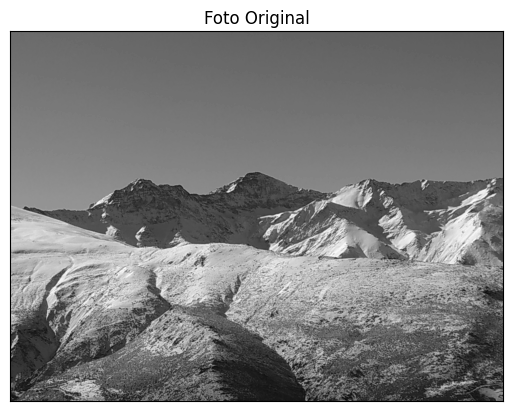

In [ ]:
filename = 'IMG_20220312_102944_S.jpg'
img = cv2.imread(get_image(filename),0)
displayMI_ES([img],'Foto Original',1)

Calculamos las primeras derivadas de la imagen:

In [ ]:
# Compute image derivatives
def derivatives(im,sigmaD):
  dx = my2DConv(im,sigmaD,[1,0])
  dy = my2DConv(im,sigmaD,[0,1])
  return dx,dy

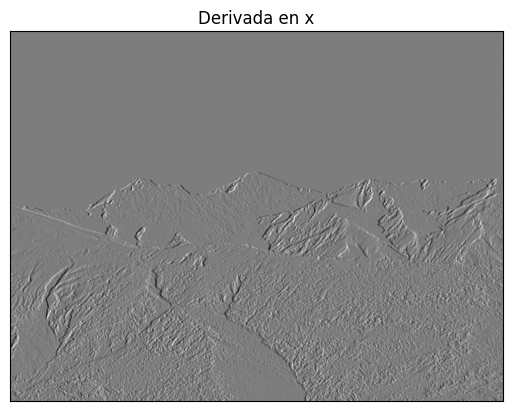

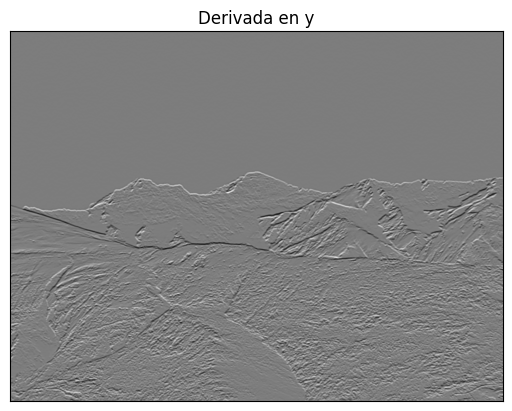

In [ ]:
dx, dy = derivatives(img,sigmaD)

# Utilizamos rangeDisplay01 ya que dx y dy tienen valores negativos
displayMI_ES([rangeDisplay01(dx,True)],'Derivada en x', 1)
displayMI_ES([rangeDisplay01(dy,True)],'Derivada en y', 1)

Podemos comprobar que en la derivada en x se marcan los bordes verticales, mientras que en la derivada en y se marcan los bordes horizontales. Por lo que en principio, parece que todo funciona correctamente.

Tal y como se detalla en la teoría (slides 33 y 34), Harris no utiliza directamente la matriz:

$$ \begin{bmatrix}
   I_x^2(\sigma_D) & I_xI_y(\sigma_D) \\
   I_xI_y(\sigma_D) & I_y^2(\sigma_D) \\
   \end{bmatrix}
$$

En su lugar, las 3 imágenes anteriores (nótese que los términos de la antidiagonal son iguales, por lo que solo tenemos que calcular tres términos) se convolucionan con un filtro Gaussiano de suavizado, con $\sigma = \sigma_I$. De esta forma, se consigue dar más importancia a los píxeles de la ventana más cercanos al píxel central.

Por tanto, la matriz que utiliza el detector de Harris para la detección de esquinas (a la que nos referiremos indistintamente como Second Moment Matrix, o $H$) se obtiene de:

$$ SMM = H = G(\sigma_I) * \begin{bmatrix}
   I_x^2(\sigma_D) & I_xI_y(\sigma_D) \\
   I_xI_y(\sigma_D) & I_y^2(\sigma_D) \\
   \end{bmatrix}
$$

, donde $G$ es un filtro de suavizado gaussiano.

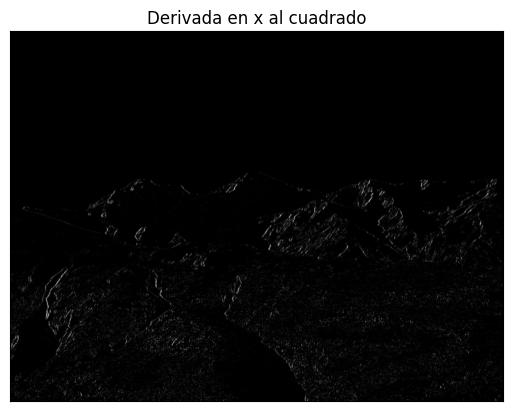

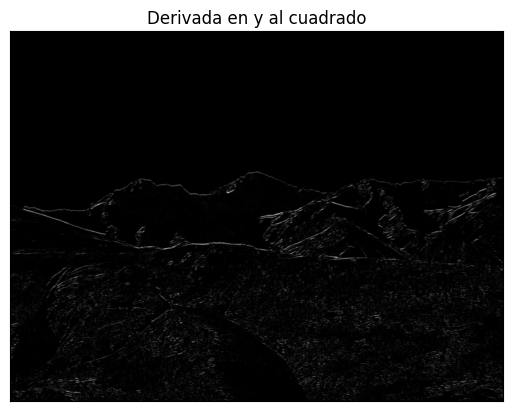

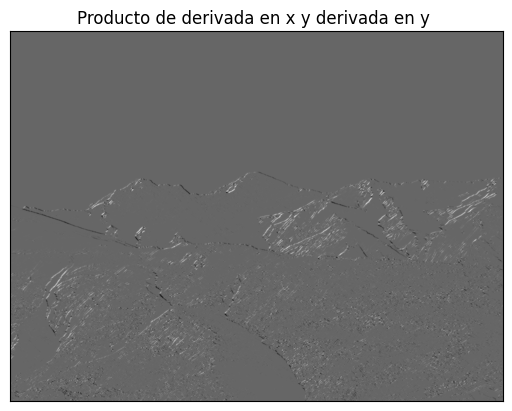

In [ ]:
Ix2 = np.multiply(dx,dx)
IxIy = np.multiply(dx,dy)
Iy2 = np.multiply(dy,dy)

displayMI_ES([rangeDisplay01(Ix2,True)],'Derivada en x al cuadrado', 1)
displayMI_ES([rangeDisplay01(Iy2,True)],'Derivada en y al cuadrado', 1)
displayMI_ES([rangeDisplay01(IxIy,True)],'Producto de derivada en x y derivada en y ', 1)

En la imagen en las que se calcula el cuadrado de las derivada en x, se obtiene una imagen en la que se acentúan los bordes verticales, mientras que el resto de la imagen es prácticamente inapreciable.

Lo mismo ocurre cuando calculamos el cuadrado de la derivada en y, pero con los bordes horizontales.

En el producto de la derivada en x y derivada en y se acentúan tanto los bordes en x como en y.

Nótese que tanto en la primera imagen como en la segunda imagen todos los valores que se obtienen son positivos (ya que estamos elevando al cuadrado), mientras que al calcular $I_xI_y$, existen valores positivos y negativos.

Podemos ya calcular $H$:

In [ ]:
# Compute Harris-criterium Map
def HarrisMap(dx,dy,sigmaI):

  Ix2 = np.multiply(dx,dx)
  Ix2 = my2DConv(Ix2,sigmaI,[0,0])

  IxIy = np.multiply(dx,dy)
  IxIy = my2DConv(IxIy,sigmaI,[0,0])

  Iy2 = np.multiply(dy,dy)
  Iy2 = my2DConv(Iy2,sigmaI,[0,0])

  HMap = [[Ix2, IxIy],[IxIy,Iy2]]

  # A COMPLETAR POR EL ALUMNADO
  return HMap

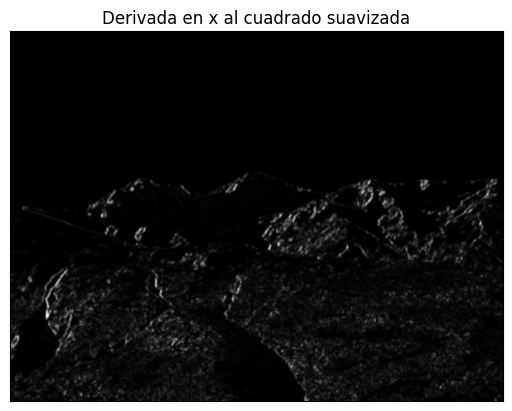

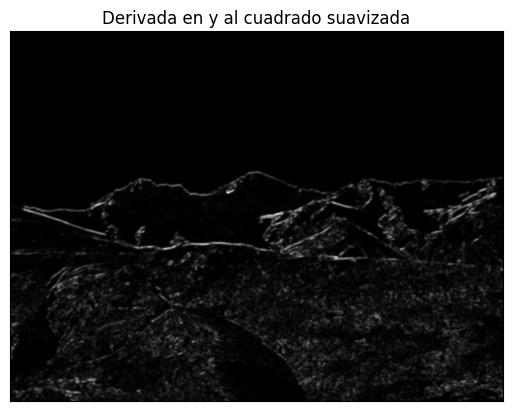

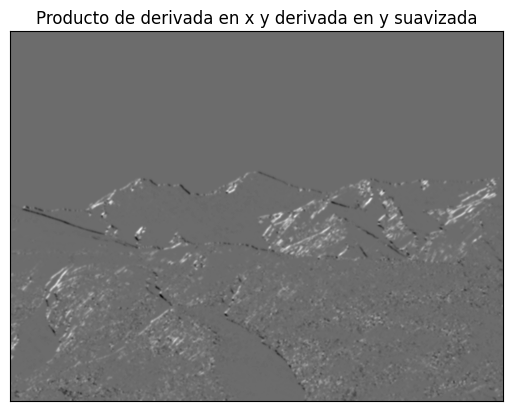

In [ ]:
dx, dy = derivatives(img,sigmaD)
HMap = HarrisMap(dx, dy, sigmaI)

displayMI_ES([rangeDisplay01(HMap[0][0],True)],'Derivada en x al cuadrado suavizada', 1)
displayMI_ES([rangeDisplay01(HMap[1][1],True)],'Derivada en y al cuadrado suavizada', 1)
displayMI_ES([rangeDisplay01(HMap[0][1],True)],'Producto de derivada en x y derivada en y suavizada', 1)


y obtenemos imágenes con bordes más suavizados.

Calcularemos ahora el valor de Harris $R$. Una de las formas de calcularlo sería:
$$
R = \frac{det(H)}{trace(H)}
$$

$H$ es la matriz de una elipse con ejes los valores principales de $H$, por lo que en principio, tanto $det(H)$ (producto de valores propios) como $trace(H)$ (suma de valores propios) serán positivos (en general, no será 0 por el ruido inherente de la imagen, que impedirá que haya zonas totalmente constantes). Por tanto sabemos que, en general, $R > 0$.

Tanto $det(H)$ como $trace(H)$, podemos calcularlos en cada punto, es decir:
$$
R(x,y) = \frac{det(H)(x,y)}{trace(H)(x,y)}
$$

, por tanto obtendremos un valor de $R$ para cada píxel, que es lo que llamaremos mapa de respuestas de Harris.

In [ ]:
Ix2 = HMap[0][0]
Iy2 = HMap[1][1]
IxIy = HMap[0][1]

detH = np.multiply(Ix2,Iy2) - np.multiply(IxIy,IxIy)
traceH = Ix2 + Iy2

HarrisResponse = detH / traceH

Efectivamente, cada valor de $R$ es mayor que 0:

In [ ]:
HarrisResponse.min()

2.6336459856581727e-08

y ahora finalmente mostramos el mapa de respuestas obtenido, comparando con la imagen original:

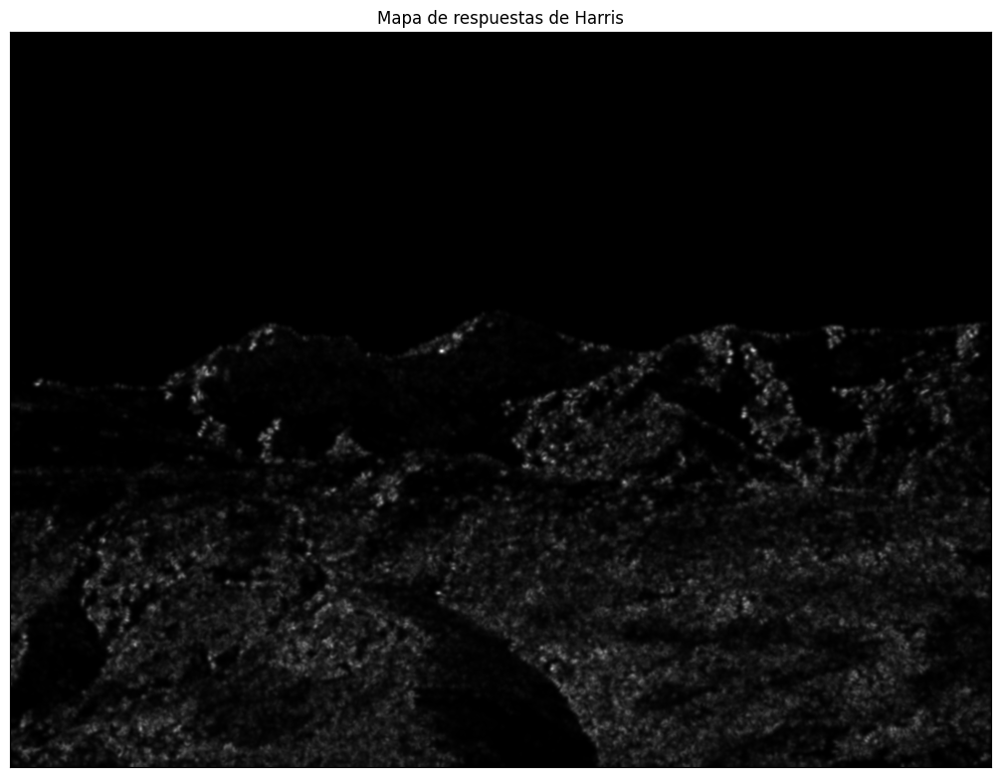

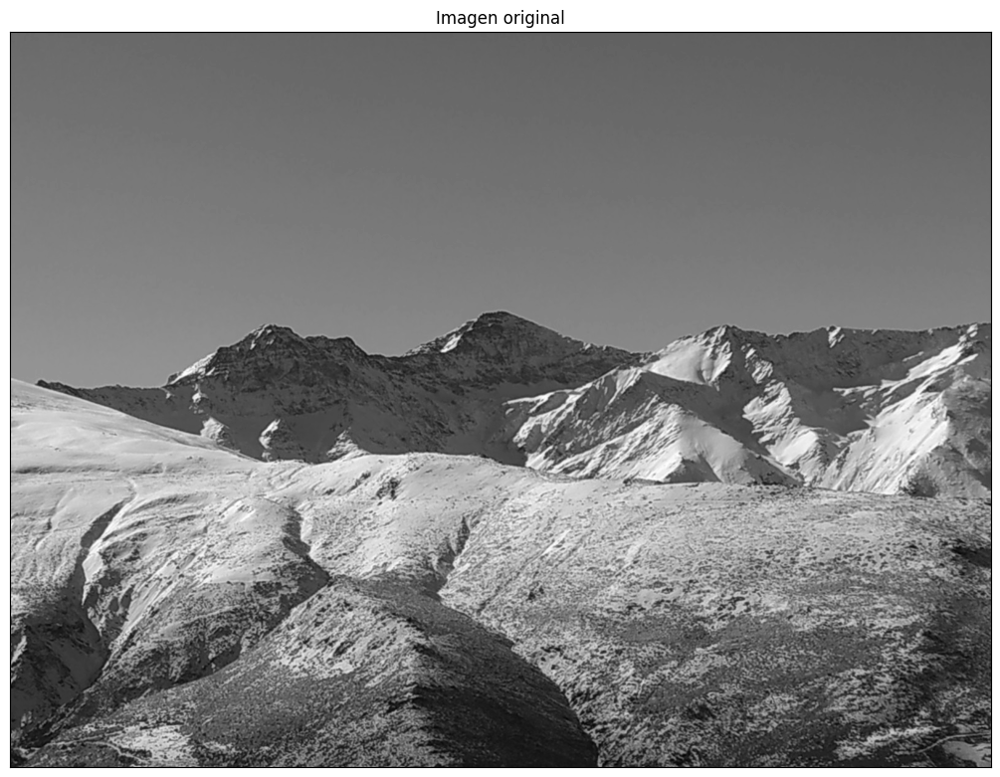

In [ ]:
displayMI_ES([rangeDisplay01(HarrisResponse,True)],'Mapa de respuestas de Harris', 2.0)
displayMI_ES([rangeDisplay01(img,True)],'Imagen original', 2.0)

Las zonas oscuras de la imagen anterior son zonas en las que $R$ es muy cercano a 0, es decir, zonas en las que Harris no detecta ningún punto de interés. Es, por tanto, bastante lógico que tanto el cielo, como zonas prácticamente constantes de la parte de abajo de la imagen, estén totalmente negras.

También tiene mucho sentido que los puntos más brillantes (más blancos) se encuentren en los picos de la parte media de la imagen. Parece lógico pensar que en esas zonas en donde se encuentran gran parte de las esquinas de la imagen.

En la imagen anterior no quedaba claro qué puntos eran los keypoints de la imagen. Para que en cada entorno de un píxel de la imagen solo se detecte un punto de interés podemos usar `NonMaximaSuppression`.

Para ello (slide 11), desplazamos por la imagen una ventana de cierto tamaño $k$. En cada posición, si el píxel en el centro es el máximo valor en la ventana, nos lo quedamos. En caso contrario, lo eliminamos (lo ponemos a 0).

Utilizamos para ello la función `corner_peaks` de SciKitLearn. Para aplicarla es necesario proporcionar los valores `min_distance` y `threshold_abs`:
- `min_distance` es la distancia mínima que debe existir entre los keypoints detectados. Por defecto, es la distancia de Chebychev, por lo que es equivalente al tamaño de la ventana (cuadrada) que hemos mencionado anteriormente.
- `threshold_abs` es el valor mínimo para que un punto se tenga en consideración como keypoint. Valores menores de intensidad serán puestos directamente a 0.

Elegiremos estos valores teniendo en cuenta que debemos localizar entre 450-500 puntos de interés.

Para determinar un rango de valores para el threshold interesante, podemos calcular varios histogramas de la respuesta de Harris: uno de toda la imagen y uno de cada tercio de la imagen (ya que hemos observado que cada tercio es muy distinto de los otros):

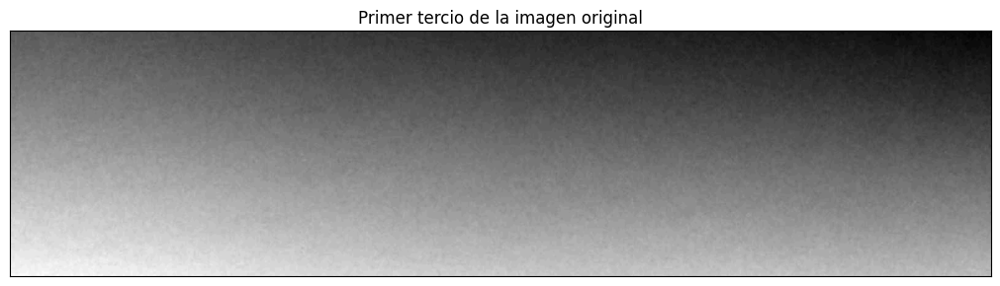

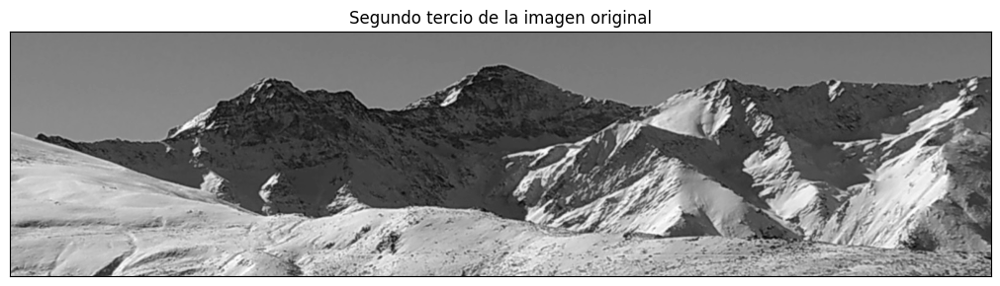

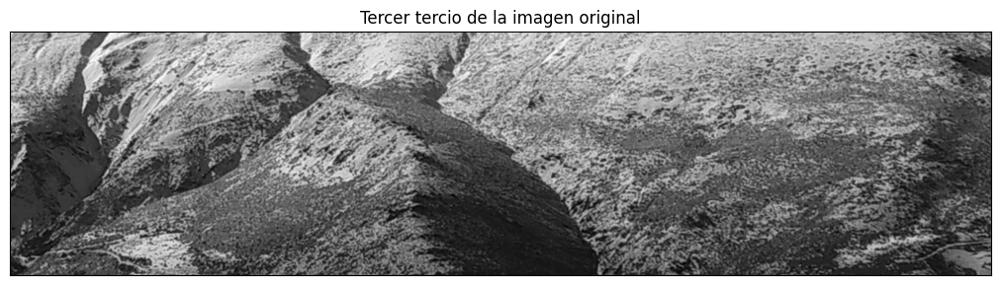

In [ ]:
first_third = img[0:int(1200/3)+1]
second_third = img[int(1200/3)+1: int(2*1200/3)+1]
third_third = img[int(2*1200/3)+1:]

displayMI_ES([first_third],'Primer tercio de la imagen original', 2.0)
displayMI_ES([second_third],'Segundo tercio de la imagen original', 2.0)
displayMI_ES([third_third],'Tercer tercio de la imagen original', 2.0)

In [ ]:
first_third = HarrisResponse[0:int(1200/3)+1]
second_third = HarrisResponse[int(1200/3)+1: int(2*1200/3)+1]
third_third = HarrisResponse[int(2*1200/3)+1:]


def frecuenciasAcumuladas(img, title, k=1000, num_bins_to_show = 5):
  m = np.min(img)
  M = np.max(img)
  bins = np.arange(m, M, (M-m)/k)

  # Calculamos el histograma acumulado inverso
  histograma, _ = np.histogram(img, bins=bins)
  total_pixeles = np.sum(histograma)
  histograma_acumulado_inverso = total_pixeles - np.cumsum(histograma) + histograma

  plt.grid(True)
  plt.plot(bins[-num_bins_to_show-1:-1], histograma_acumulado_inverso[-num_bins_to_show:], color='b')
  plt.title(title)
  plt.xlabel(f'R mayor o igual a')
  plt.ylabel('Número de píxeles')
  plt.show()


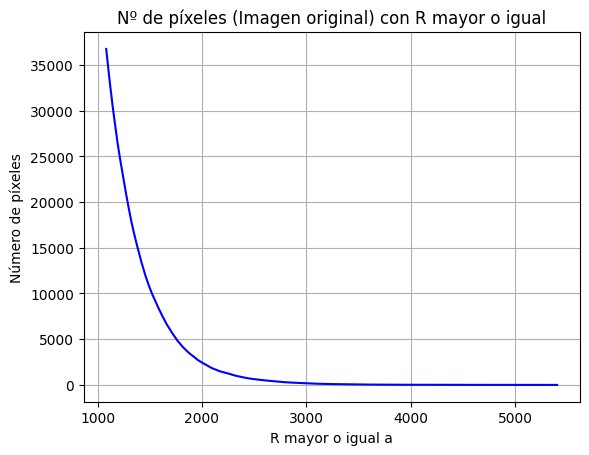

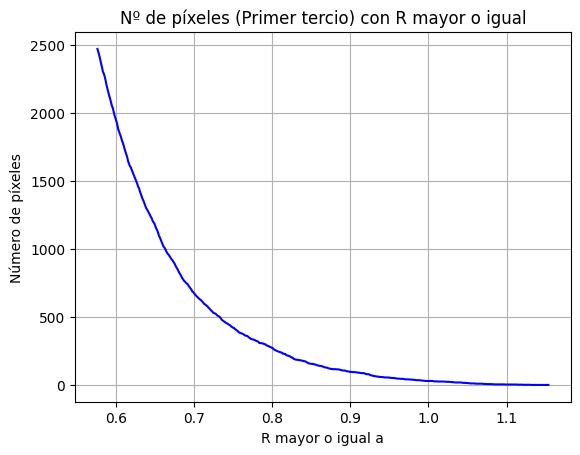

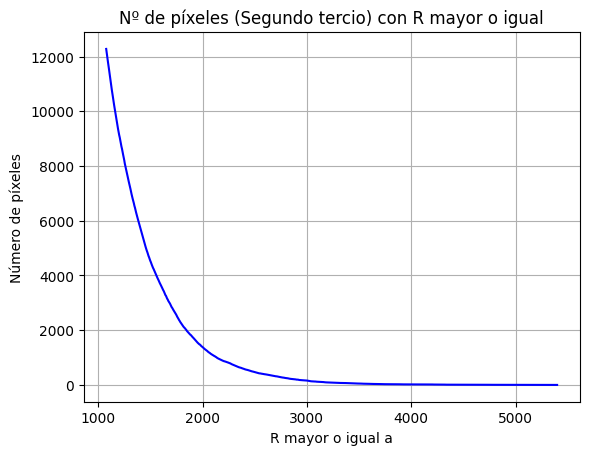

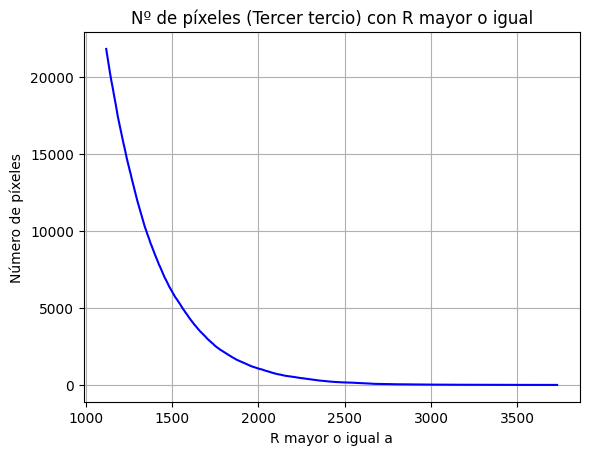

In [ ]:
frecuenciasAcumuladas(HarrisResponse, 'Nº de píxeles (Imagen original) con R mayor o igual', k=1000, num_bins_to_show = 800)
frecuenciasAcumuladas(first_third, 'Nº de píxeles (Primer tercio) con R mayor o igual', k=1000, num_bins_to_show = 500)
frecuenciasAcumuladas(second_third, 'Nº de píxeles (Segundo tercio) con R mayor o igual', k=1000, num_bins_to_show = 800)
frecuenciasAcumuladas(third_third, 'Nº de píxeles (Tercer tercio) con R mayor o igual', k=1000, num_bins_to_show = 700)

Salvo en el primer tercio de la imagen (que no se debe tener en cuenta ya que en el cielo de la imagen no hay keypoints), casi todas las gráficas indican que se puede elegir como threshold un valor de entre 1000 y 2000. Hay que tener en cuenta que cuando aumentemos `min_distance`, el número de keypoints se reducirá bastante, por lo que tenemos que elegir valores que dejen por debajo un número de keypoints bastante más elevado de 500.

En la imagen original, para 1000 se obtienen más de 30 mil puntos, mientras que para 2000 se obtienen más de 2000 puntos, por lo que parece lógico pensar que con estos valores será suficiente.

Nótese que las gráficas anteriores confirman el hecho de que la parte central de la imagen es donde se encuentran los keypoints más destacados, ya que se observa una gran cantidad de puntos con una respuesta bastante elevada.

Pasamos ahora a determinar un valor posible para `min_distance`:

In [ ]:
img.shape

(1200, 1600)

En primer lugar, las dimensiones de nuestra imagen son cercanas a los 1000 píxeles. Por tanto, si queremos detectar suficientes keypoints tendremos que elegir valores de `min_distance` bastante menores de 1000. En principio, parece razonable no elegir valores excesivamente reducidos como 1 (no se suprime ningún keypoint, y  en cada zona hay multitud de keypoints) ni valores superiores a 20 (no tendría mucho sentido que se suprima un keypoint porque otro keypoint a una distancia considerable tenga un mayor valor).

Parece que una ventana de en torno a 10x10 puede ser bastante razonable. Comprobemos en estos valores cuántos keypoints se detectan:

In [ ]:
from skimage.feature import corner_peaks

def NonMaximaSuppression(harrisMap, min_distance, threshold):
  return corner_peaks(harrisMap, min_distance=min_distance, threshold_abs=threshold)

In [ ]:
threshold_possible_values = np.arange(1000,2000,100)
min_distance_possible_values = [7,8,9,10,11,12,13]

values = []

for threshold in threshold_possible_values:
  for min_distance in min_distance_possible_values:
    values.append([threshold, len(NonMaximaSuppression(HarrisResponse, min_distance, threshold)), min_distance])

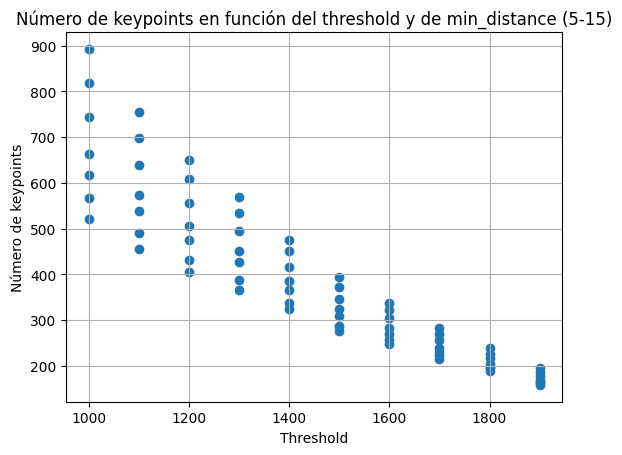

In [ ]:
values = np.array(values)
plt.scatter(values[:,0],values[:,1])
plt.grid(True)
plt.title('Número de keypoints en función del threshold y de min_distance (5-15)')
plt.xlabel('Threshold')
plt.ylabel('Número de keypoints')
plt.show()

,donde se ha mostrado cuántos keypoints se obtienen para un distintos thresholds entre 1000 y 2000 (eje X) y diferentes tamaños de ventana (de 5 a 15).

y obtenemos como posibles valores:

In [ ]:
[v for v in values if 450 <= v[1] <= 500]

[array([1100,  490,   12]),
 array([1100,  456,   13]),
 array([1200,  475,   11]),
 array([1300,  495,    9]),
 array([1300,  451,   10]),
 array([1400,  476,    7]),
 array([1400,  450,    8])]

Cualquiera de estos valores es ya bastante razonable de elegir. La elección de estos valores dependerá ya de cómo preferimos los keypoints. Si queremos que aparezcan keypoints con una respuesta más elevada, aunque aparezcan más cerca podríamos elegir, por ejemplo, `[1400,  476,    7]`; si queremos que aparezcan keypoints con una respuesta no tan elevada, pero que aparezcan más alejados podríamos elegir `[1100,  490,   12]`.

En este caso, elegiremos la primera opción, por lo que esperamos un resultado con más puntos en la zona media de la imagen (bastante cercanos), mientras que en la parte de abajo habrá menos keypoints.

La lista de keypoints será:

In [ ]:
threshold = 1400
min_distance = 7

coordinates = NonMaximaSuppression(HarrisResponse,min_distance,threshold)
keypoints = np.zeros((len(coordinates),3))

for ind, coordinate in enumerate(coordinates):
  keypoints[ind][0] = coordinate[0]
  keypoints[ind][1] = coordinate[1]
  keypoints[ind][2] = HarrisResponse[coordinate[0],coordinate[1]]

print(len(keypoints))
keypoints[0:15]

476


array([[ 521.        ,  704.        , 5408.95574259],
       [ 521.        , 1212.        , 4324.72922982],
       [ 526.        , 1175.        , 3785.62091224],
       [ 627.        , 1196.        , 3747.44728701],
       [1039.        ,  884.        , 3737.69481868],
       [ 539.        , 1172.        , 3666.30972941],
       [ 598.        ,  300.        , 3562.68702208],
       [ 916.        ,  699.        , 3553.7932544 ],
       [ 696.        ,  871.        , 3397.96944757],
       [ 497.        , 1567.        , 3362.29137487],
       [ 559.        ,  321.        , 3293.00630182],
       [ 511.        ,  397.        , 3186.38758834],
       [ 657.        ,  309.        , 3167.81493815],
       [ 735.        , 1002.        , 3156.1572464 ],
       [ 647.        ,  434.        , 3154.19749289]])

Mostramos el mapa de Harris umbralizado. Para ello, ponemos a 0 todos los valores que no superan el umbral:

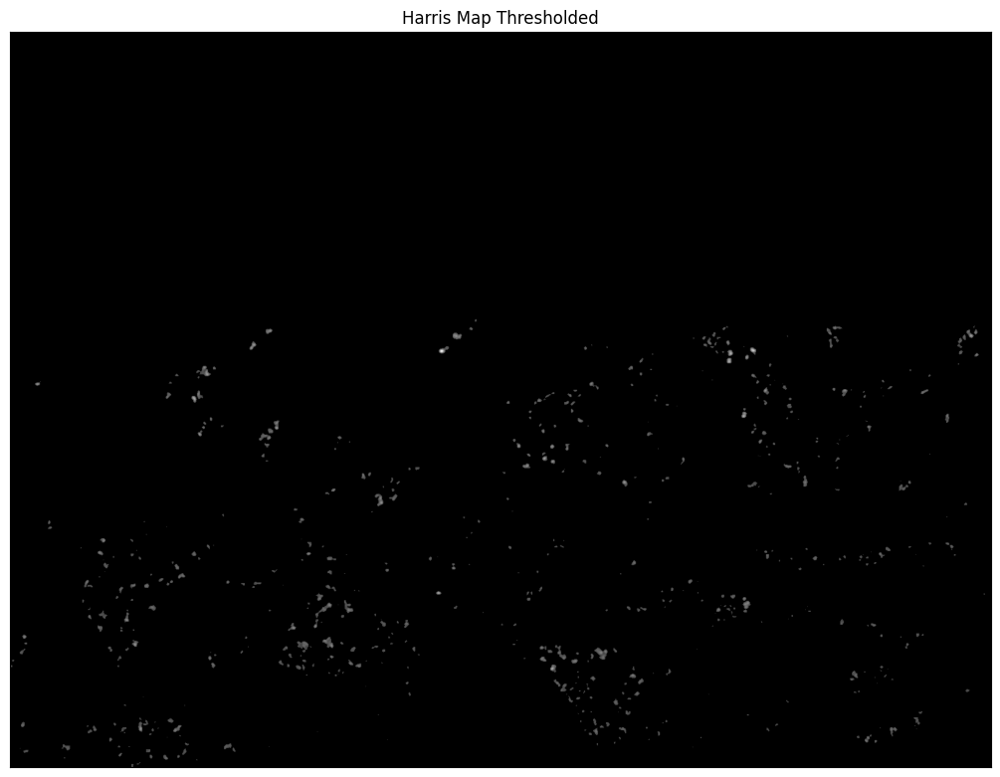

In [ ]:
# Threshold
HarrisThresholded = np.zeros_like(HarrisResponse)

for i in range(HarrisResponse.shape[0]):
  for j in range(HarrisResponse.shape[1]):
    if HarrisResponse[i,j] > threshold:
      HarrisThresholded[i,j] = HarrisResponse[i,j]

displayMI_ES([rangeDisplay01(HarrisThresholded,True)],'Harris Map Thresholded', 2.0)

Podemos comprobar que el número de puntos detectados ya es bastante más reducido, especialmente en la zona más baja de la imagen.

No se muestra aun ninguna visualización con únicamente los 500 puntos resultado de la supresión de no máximos, ya que su visualización todavía es bastante complicada. Simplemente se vería un fondo negro y algún píxel ligeramente coloreado de blanco.

Calculamos ahora la orientación de cada punto de interés. Para mejorar el cálculo intentando reducir el ruido, se calcula la derivada con un sigma suficientemente elevado, como el sugerido en el enunciado $\sigma = 3$. Después se aplica la fórmula ya conocida:
$$
\theta = atan(\frac{\partial I}{\partial y} / \frac{\partial I}{\partial x})
$$

Posteriormente se utilizará la estructura `KeyPoint` de CV2, que requiere que el ángulo esté en grados, por lo que pasamos también el ángulo de radianes a grados:

In [ ]:
# compute the orientation map
def orientation(dx,dy):
  # Suavizamos dx y dy con sigma suficientemente elevado, como 3
  smooth_dx = my2DConv(dx,3,[1,0])
  smooth_dy = my2DConv(dy,3,[0,1])
  theta = np.arctan2(smooth_dy,smooth_dx)

  # Devolvemos el ángulo en grados
  return theta*(180 / np.pi)

Creamos una función que crea los Keypoints finales, serán objetos de la clase KeyPoint de cv2, que almacenarán la posición del keypoint, su orientación y el tamaño del círculo a mostrar para cada punto (que será en todos los casos el mismo valor):

In [ ]:
# Create the KeyPoint list from the lists of locations, orientations and scales
def keyPoints(coord,theta,size):
  keyPoints = []

  for p in coord:
    angle = theta[p[0], p[1]]

    # Por la forma en que trabaja OpenCV, es importante cambiar las coordenadas
    # Si no se hace, los keypoints aparecerán con la x y la y cambiadas
    kp = cv2.KeyPoint(float(p[1]), float(p[0]), size, angle)
    keyPoints.append(kp)

  return keyPoints

Calculamos los puntos de interés con la función anterior:

In [ ]:
# Tamaño suficientemente grande para que se vea el círculo
size = 4*np.floor(3*sigmaI)+1

# Calculamos las derivadas, orientación y keypoints de la imagen
dx, dy = derivatives(img,sigmaD)
theta = orientation(dx,dy)
keypoints = keyPoints(coordinates,theta,size)

y los dibujamos sobre la imagen original:

In [ ]:
from cv2 import drawKeypoints

img_color = cv2.imread(get_image(filename))
img_color = cv2.cvtColor(img_color, cv2.COLOR_BGR2RGB)
img_keypoints = drawKeypoints(img, keypoints, img_color,
                              color=(255, 0, 0),
                              flags=cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG + cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG: pintamos los keypoints sobre la imagen de salida (img_color)
# cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS: pintamos los keypoints con toda la información (incluida orientación)

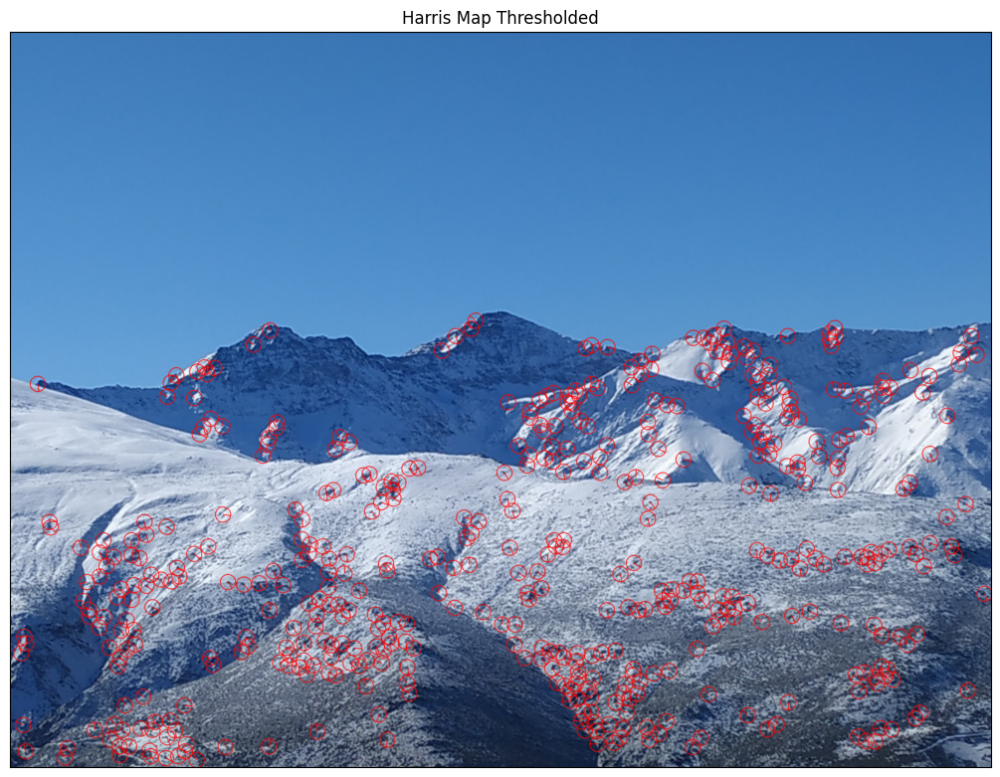

Número de keypoints detectados = 476


In [77]:
displayMI_ES([img_keypoints],'Harris Map Thresholded', 2.0)
print(f'Número de keypoints detectados = {len(keypoints)}')

Comprobamos que la implementación parece bastante correcta. Se localizan 476 keypoints. De ellos, bastantes se encuentran en la zona de las montañas, especialmente en los picos y en las distintas grietas del terreno.

No se localiza ningún keypoint en zonas totalmente lisas, como el cielo. De lo contrario, sería un claro indicador de un mal funcionamiento del detector.

En general, los keypoints parecen localizados en zonas realmente de interés, es decir, en zonas donde un ligero cambio en cualquier dirección, provoca un gran cambio en la imagen, que es lo que esperamos de un buen detector.



# <font color='blue'>**Ejercicio 2:** Emparejamiento de _keypoints_ entre imágenes usando descriptores SIFT, HOG y LBP (3 puntos)

<font color='blue'>En este apartado, partiendo de un detector de características (SIFT) y tres descriptores de características (SIFT, HOG y LBP), vamos a calcular el emparejamiento entre _keypoints_ de dos imágenes. Las imágenes con las que se trabajará en este ejercicio serán `IMG_20220312_102940_S.jpg` y `IMG_20220312_102944_S.jpg`. Estas imágenes son de $1200\times1600$ pero, tras leerlas, se debe reducir su tamaño a la mitad ($600\times800$). Es en esta última dimensionalidad en la que realizaremos todo el ejercicio y visualizaremos las imágenes. Y, a continuación, debemos pasarlas a escala de grises. Nota importante: del mismo modo que se calculan _keypoints_ y descriptores en escala de grises, luego los matches/emparejamientos sí se visualizan sobre las imágenes originales en color.

Leemos las imágenes, reduciéndolas a la mitad en ambos ejes, en escala de grises (detección y descripción de keypoints) y también a color (visualización)

In [ ]:
filename1 = 'IMG_20220312_102940_S.jpg'
filename2 = 'IMG_20220312_102944_S.jpg'

img1 = cv2.imread(get_image(filename1))
img1 = cv2.resize(img1, (0,0), fx=0.5, fy=0.5)
img1_color = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)

img2 = cv2.imread(get_image(filename2))
img2 = cv2.resize(img2, (0,0), fx=0.5, fy=0.5)
img2_color = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

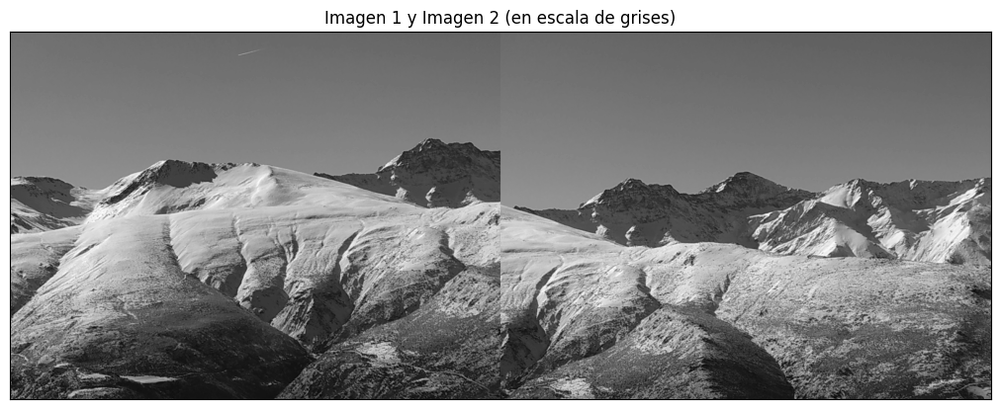

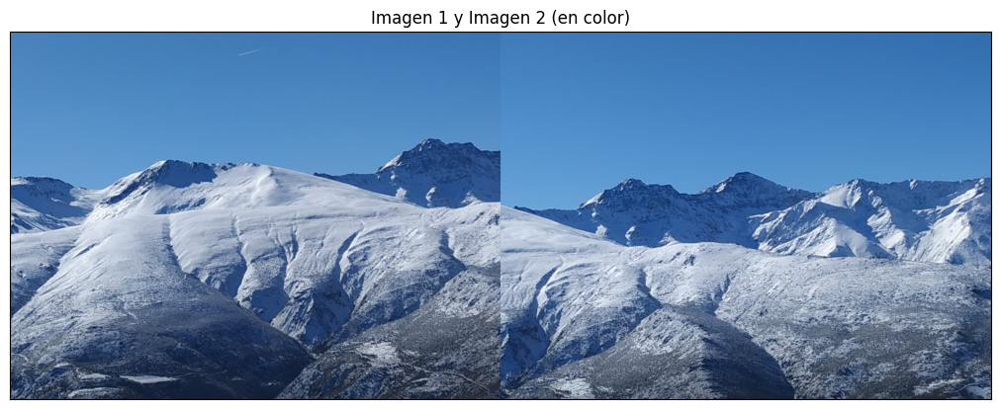

In [ ]:
displayMI_ES([img1, img2],'Imagen 1 y Imagen 2 (en escala de grises)',2.0)
displayMI_ES([img1_color, img2_color],'Imagen 1 y Imagen 2 (en color)',2.0)

Ya así a simple vista, podemos observar que el pico de la montaña que se observa a la derecha de la primera imagen, es el pico que aparece a la izquierda de la primera imagen. También podemos comprobar que coinciden las distintas marcas en la nieve de esa zona.

Por tanto, sabemos que para que un modelo funcione bien emparejando los keypoints se deberán observar rectas, ligeramente descendentes y prácticamente paralelas desde la parte derecha de la imagen izquierda hacia la parte izquierda de la imagen derecha.

## <font color='blue'>SIFT (Scale-invariant feature transform)

<font color='blue'>En un primer momento, el alumnado debe aplicar el algoritmo SIFT a ambas imágenes para extraer los puntos de interés (_keypoints_) y los descriptores (https://docs.opencv.org/3.4/dc/dc3/tutorial_py_matcher.html). Luego, vamos a emplear tres criterios de emparejamiento: _brute force_ (`cv2.BFMatcher`), _brute force with cross-check_ (`cv2.BFMatcher` con `crossCheck=True`) y el _Lowe's ratio test_ (`knnMatch`) para calcular los emparejamientos y mostrar los 100 mejores matches utilizando la función `cv2.drawMatches`.

<font color='blue'>En los siguientes apartados, emplearemos exactamente los mismos _keypoints_ detectados por SIFT para calcular otros descriptores en dichas localizaciones y comparar los resultados obtenidos. En los próximos apartados también se utilizarán y compararán los mismos tres criterios de emparejamiento indicados (_BF_, _BF+CC_ y _Lowe's ratio test_).

In [ ]:
def siftPoints(im,nfeatures=5000):
  # Initiate SIFT detector
  sift = cv2.SIFT_create(nfeatures)
  # find the keypoints and descriptors with SIFT
  kp, ds = sift.detectAndCompute(im,None)
  return kp,ds

Esta función devuelve una lista de KeyPoints (con información sobre la posición, tamaño, orientación, octava en la que se ha detectado, etc.) y una lista de descriptores, cada uno conteniendo las 16*8 características extraídas de un entorno de cada KeyPoint (SIFT toma un entorno del keypoint de 16x16 celdas, agrupadas en bloques de 4x4, y por cada bloque extrae un histograma de 8 orientaciones).

Como estamos trabajando con imágenes bastante grandes y con bastantes detalles, deberíamos limitar el número de KeyPoints que se detectan. Para ello, SIFT utiliza un score para cada KeyPoint, de manera que se quedará con los `nfeatures` mejores puntos de interés [[1]](https://docs.opencv.org/3.4/d7/d60/classcv_1_1SIFT.html).

In [ ]:
kp1, ds1 = siftPoints(img1)
kp2, ds2 = siftPoints(img2)

Como ejemplo de la información que tenemos:

In [ ]:
print(f'Posición del primer KeyPoint: {kp1[0].pt}')
print(f'Orientación en grados del primer KeyPoint: {kp1[0].angle}')
print(f'Número de características del descriptor del primer KeyPoint: {len(ds1[0])}')

Posición del primer KeyPoint: (2.274052143096924, 313.4768981933594)
Orientación en grados del primer KeyPoint: 242.5193328857422
Número de características del descriptor del primer KeyPoint: 128


Resulta curioso que, para obtener una mejor precisión, SIFT trabaja en coordenadas en coma flotante.

In [ ]:
# This function display the KeyPoints of an image
def showKP(im,kp,title):
  img = im.copy()
  cv2.drawKeypoints(im, kp, img,
                    flags=cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG + cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
  displayIm(img,title,1)

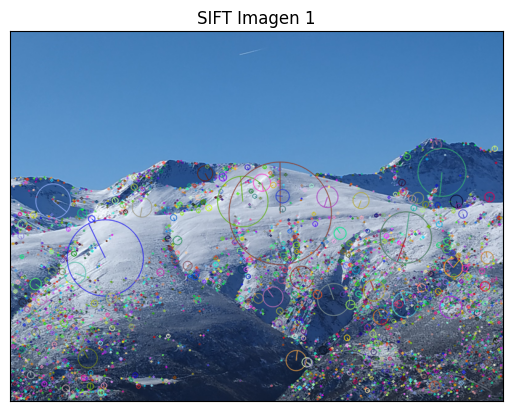

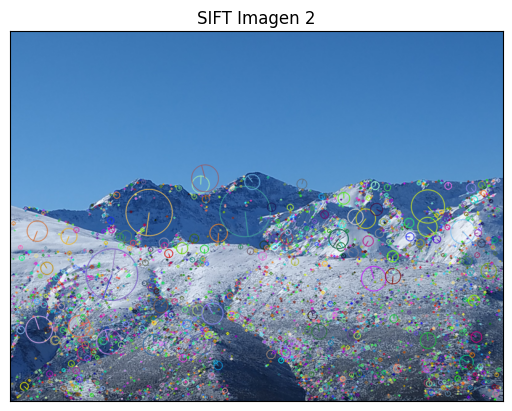

In [ ]:
showKP(img1_color,kp1,'SIFT Imagen 1')
showKP(img2_color,kp2,'SIFT Imagen 2')

Se muestra, en cada imagen, una cantidad enorme de keypoints (y en caso de no haber limitado `nfeatures` el número sería aun mayor).

De nuevo, parece que el modelo funciona bastante bien en la identificación, ya que no localiza ningún keypoint en zonas totalmente constantes, como puede ser el cielo.

SIFT, a diferencia de Harris, es invariante a la escala, por lo que entre la información que incluye un keypoint se encuentra la escala a la que se ha detectado. Es por ello que cada keypoint tiene un `size` distinto (a mayor $\sigma$, mayor diámetro del círculo). También puede llegar a incluir, para una misma posición, dos keypoints para los que cambia la orientación (la orientación más votada y otra orientación si llega a superar el 80% de los "votos" de la primera). Es por ello que en algunos círculos se observan dos líneas.

In [ ]:
# This function display the best N matches between two images
def showMatches(im1,kp1,im2,kp2,matches, N, title='Matches'):
  # Flag DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS = dibujar solo keypoints emparejados
  imBF=cv2.drawMatches(im1,kp1,im2,kp2,matches[:N],None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
  displayIm(imBF,title,2)

#This function compute matches between descriptors of two images
def matching(ds1,ds2,FlagMode='BF+CC'):
  if FlagMode=='BF':
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
    matches = bf.match(ds1,ds2)
    matches = sorted(matches, key = lambda x:x.distance)
    return matches
  elif FlagMode=='BF+CC':
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
    matches = bf.match(ds1,ds2)
    matches = sorted(matches, key = lambda x:x.distance)
    return matches
  elif FlagMode=='KNN':
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
    matches = bf.knnMatch(ds1,ds2,k=2)
    # Apply ratio test
    good = []
    for m,n in matches:
        if m.distance < 0.75*n.distance:
            good.append(m)
    good = sorted(good, key = lambda x:x.distance)
    return good
  else:
    return print('Error in Matching mode')

Antes de proceder, expliquemos cada uno de los métodos de matching que utilizaremos:

- *Brute Force*: Se le asigna a cada descriptor de la imagen 1 el descriptor más cercano de la imagen 2, utilizando algún criterio para medir la cercanía. En general, en todos los descriptores que utilizaremos, se suele utilizar la distancia euclídea entre los dos descriptores (`cv2.NORM_L2`) [[2]](https://docs.opencv.org/3.4/dc/dc3/tutorial_py_matcher.html).

- *Brute Force + Cross Check*: Una primera mejora de BF, se calcula (utilizando alguna distancia) el descriptor más cercano de la imagen 2. El emparejamiento será válido si obtenemos el mismo par de puntos de interés en ambas direcciones (es decir, cada punto de interés es el mejor emparejamiento del otro).

- *Lowe's ratio test*: Propuesto por el creador de SIFT, intenta mejorar aun más los emparejamientos. Tal y como se describe en el paper de Lowe [[3]](https://www.cs.ubc.ca/~lowe/papers/ijcv04.pdf#page=20), dado un descriptor en la imagen 1 $f_1$ se calcula el descriptor más cercano en la imagen 2 $f_2$, y el segundo más cercano en la imagen 2 $f_2'$. Se calcula entonces el cociente:
$$
0 \leq \frac{||f_1-f_2||}{||f_1 - f_2'||} \leq 1
$$
Cuando este cociente es bastante pequeño, querrá decir que el emparejamiento no es nada ambiguo y se debe considerar. En caso contrario, querrá decir que el emparejamiento puede ser ambiguo y que hay que desecharlo.
Lowe determinó empíricamente que si el anterior valor era mayor que 0.7-0.75, muchos emparejamientos eran incorrectos. Por tanto, se deberá comprobar que el cociente sea menor de 0.75 (también se podría elegir 0.7), y en caso contrario, desechar el match.

Calculamos los matches:

In [ ]:
# Nos quedamos con los 100 mejores matches
numberOfmatches = 100

In [ ]:
matchesBF = matching(ds1,ds2,'BF')
matchesBFCC = matching(ds1,ds2,'BF+CC')
matchesKNN = matching(ds1,ds2,'KNN')

Mostramos los matches:

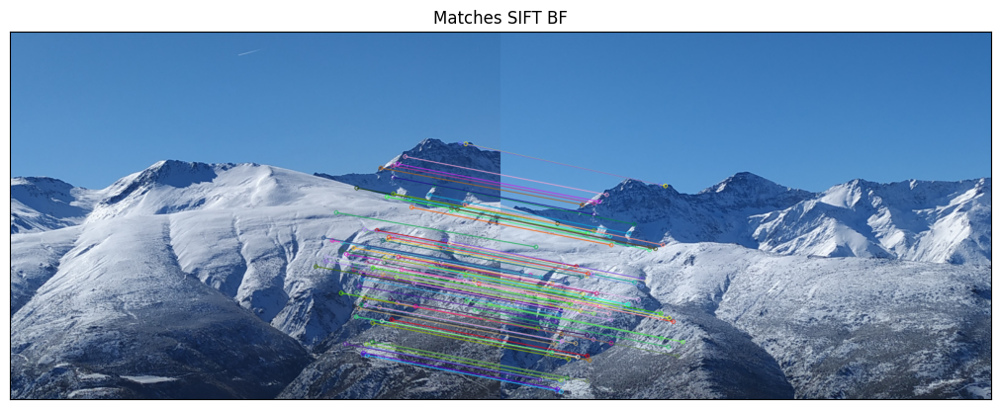

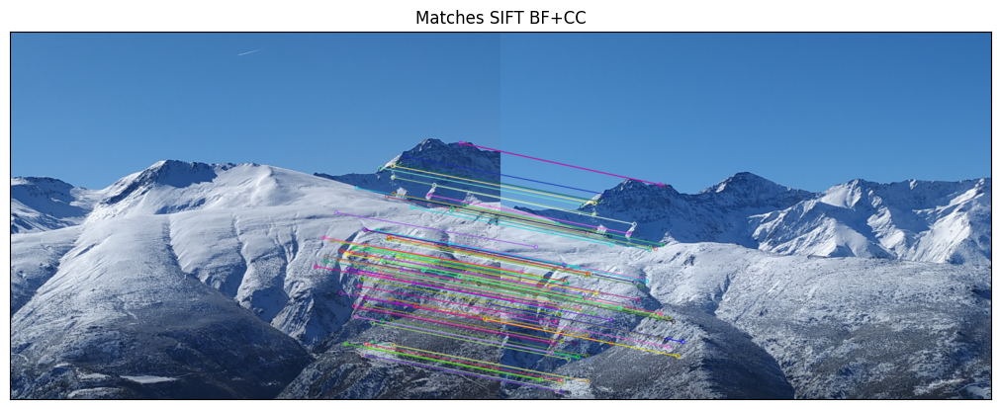

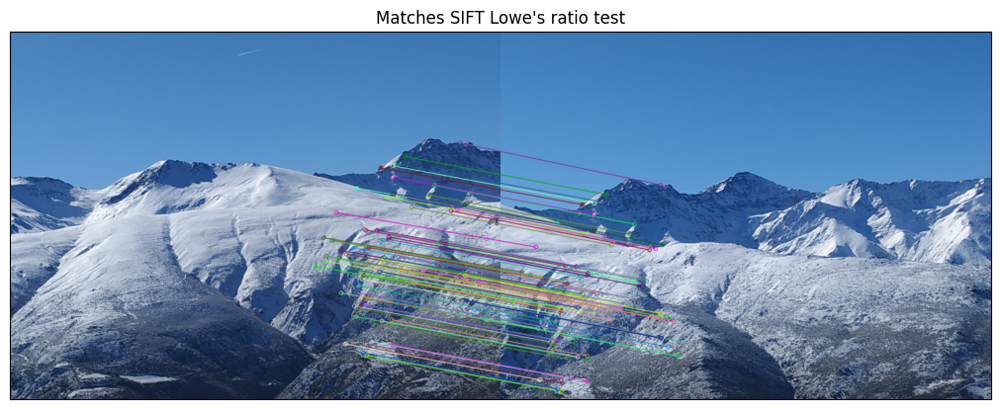

In [ ]:
showMatches(img1_color,kp1,img2_color,kp2,matchesBF, numberOfmatches, title='Matches SIFT BF')
showMatches(img1_color,kp1,img2_color,kp2,matchesBFCC, numberOfmatches, title='Matches SIFT BF+CC')
showMatches(img1_color,kp1,img2_color,kp2,matchesKNN, numberOfmatches, title='Matches SIFT Lowe\'s ratio test')

Comprobamos que el emparejamiento es perfecto.

Observamos las líneas descendentes y paralelas de izquierda a derecha que comentamos al mostrar las imágenes. Además, las líneas unen puntos que visualmente parecen la misma zona.

No se observan diferencias significativas entre los distintos métodos de matching, y es que el matching es prácticamente perfecto incluso utilizando fuerza bruta. De hecho, en las tres imágenes se muestran prácticamente los mismos matches.

## <font color='blue'>LBP (Local Binary Patterns)

<font color='blue'>Ahora, vamos a hacer lo mismo de antes, pero empleando las características LBP (del paquete `mahotas`: `mahotas.features.lbp`). Para ello debemos crear una pequeña ventana ($7\times7$ pixels) centrada en torno a los SIFT keypoints detectados, y calcular el vector de características correspondiente (empleando `radius=1` y `points=8`).

<font color='blue'>¿Posee este vector de características el tamaño indicado en teoría? Si no es así, ¿a qué se puede deber?


In [ ]:
!pip install mahotas

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.8/5.8 MB 41.5 MB/s eta 0:00:00


LBP, tal y como se ha visto en la teoría consiste en lo siguiente:
- Se toma un entorno 3x3 de un píxel (si empleamos `radius=1` y `points=8`).
- Si un píxel del entorno tiene una intensidad menor o igual que el píxel central, entonces se le asigna un 1. En caso contrario, se le asigna un 0.
- Se asigna un orden (el mismo siempre que apliquemos el método) a los píxeles vecinos (distintos del centro), de manera que se obtenga un número de 8 dígitos en binario. Se calcula el número en decimal, y ese será el descriptor.
- Con 8 dígitos, podemos escribir 256 valores, por lo que nuestro descriptor tendrá ese tamaño. Por tanto, si realizamos LBP en una ventana de 7x7, deberíamos obtener un vector de tamaño 256, y en el índice i, se encontraría la cantidad de píxeles para los que se obtiene el valor i, utilizando el proceso descrito en el anterior apartado.

Tal y como se describe en [[4]](https://mahotas.readthedocs.io/en/latest/lbp.html), el entorno que se toma (utilizando `radius` y `points`) no necesariamente cae exactamente en píxeles vecinos, sino que en algunos casos se utiliza interpolación, para determinar el entorno.

Determinamos ahora para cada keypoint una ventana de 7x7 para cada keypoint, y aplicamos lbp en esa ventana:

In [ ]:
import mahotas

# Función para extraer el descriptor LBP basado en una ventana 7x7 centrada en el keypoint
def extract_lbp_descriptor_around_keypoint(keypoint, img, window_size=7, radius=1, points=8):
    # Obtener las coordenadas del keypoint
    x, y = int(keypoint.pt[0]), int(keypoint.pt[1])

    # Definir la ventana 7x7 centrada en torno al keypoint
    half_window = window_size // 2
    window = img[y-half_window:y+half_window+1, x-half_window:x+half_window+1]

    if window.shape[0] != window_size or window.shape[1] != window_size:
        return None  # Si la ventana se sale de los bordes de la imagen

    # Calcular el LBP de la ventana utilizando mahotas.features.lbp
    lbp = mahotas.features.lbp(window, radius, points)

    return lbp

# Extraer y visualizar los descriptores HOG alrededor de cada keypoint
ds1 = [extract_lbp_descriptor_around_keypoint(kp, img1) for kp in kp1]
ds2 = [extract_lbp_descriptor_around_keypoint(kp, img2) for kp in kp2]

# Filtrar descriptores válidos
valid_kp1, ds1 = zip(*[(kp, desc) for kp, desc in zip(kp1, ds1) if desc is not None])
valid_kp2, ds2 = zip(*[(kp, desc) for kp, desc in zip(kp2, ds2) if desc is not None])

# Convertir descriptores a numpy array
ds1 = np.array(ds1, dtype=np.uint8)
ds2 = np.array(ds2, dtype=np.uint8)

Veamos qué tamaño tiene el descriptor de los keypoints:

In [ ]:
print(ds1[0])
print(f'Tamaño del descriptor = {len(ds1[0])}')

[17  5 11  1  3  0  0  0  2  0  0  0  0  0  1  0  2  0  0  0  0  0  0  0
  0  0  0  1  0  0  0  0  3  0  3  0]
Tamaño del descriptor = 36


Comprobamos que el descriptor tiene tamaño 36, algo que no concuerda con los 256 que esperábamos por lo visto en teoría.

Si accedemos a la documentación de mahotas [[4]](https://mahotas.readthedocs.io/en/latest/lbp.html), comprobamos que la implementación que se usa está basada en el paper [[5]](https://www.researchgate.net/publication/221303862_Gray_Scale_and_Rotation_Invariant_Texture_Classification_with_Local_Binary_Patterns). Tal y como se explica (páginas 5 y 6), para mejorar el método tradicional de LBP, y aportar cierta invarianza a las rotaciones, se simplifican las 256 posibles combinaciones de la siguiente forma:
- Si desplazamos (de forma circular) los dígitos de un número hacia la derecha, los números que obtenemos se consideran equivalentes al primero. Por ejemplo, los siguientes números serían equivalentes:
$$
00100000, 00010000, 000000100, 10000000
$$
,ya que se van obteniendo al desplazar el dígito 1 hacia la derecha. Se pueden tomar 36 números binarios de 8 dígitos (listados en la página 6 del paper), de manera que cualquier número binario de 8 cifras será equivalente a alguna de esas 36 combinaciones.

Por tanto, el descriptor es un vector de tamaño 36, que en la posición i almacena cuántos píxeles de la ventana de 7x7 obtienen un valor LBP equivalente al número asociado a la combinación i. Es por ello, que los números del vector suman 49 (7x7):

In [ ]:
np.sum(ds1[0])

49

Se calculan los matches, y se muestran en las imágenes a color:

In [ ]:
matchesBF = matching(ds1,ds2,'BF')
matchesBFCC = matching(ds1,ds2,'BF+CC')
matchesKNN = matching(ds1,ds2,'KNN')

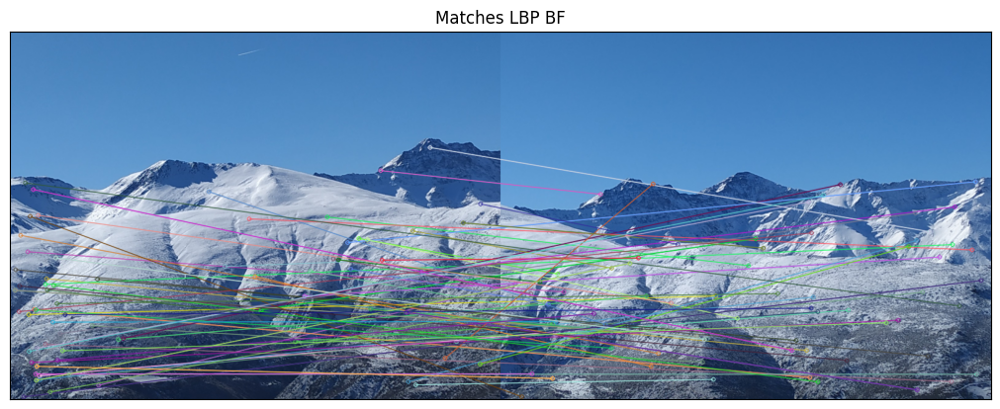

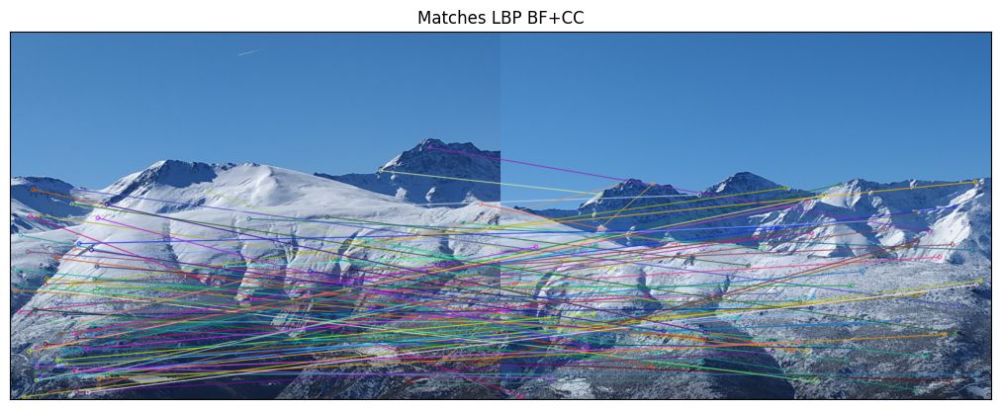

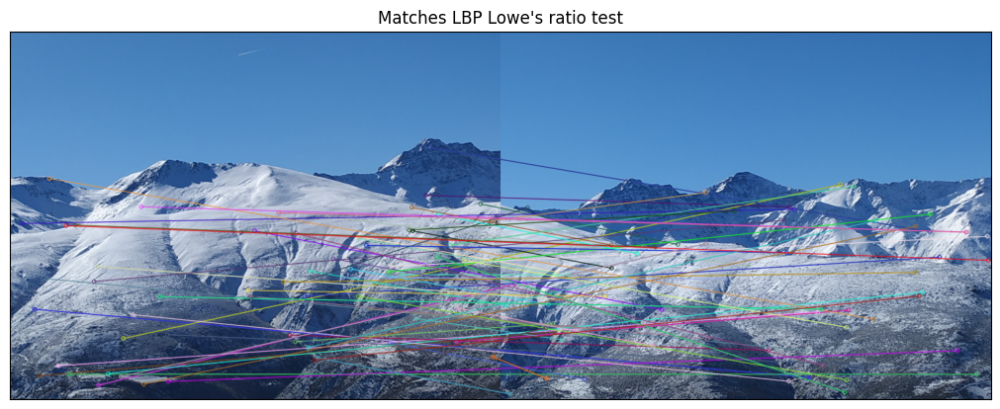

In [ ]:
showMatches(img1_color,valid_kp1,img2_color,valid_kp2,matchesBF, numberOfmatches, title='Matches LBP BF')
showMatches(img1_color,valid_kp1,img2_color,valid_kp2,matchesBFCC, numberOfmatches, title='Matches LBP BF+CC')
showMatches(img1_color,valid_kp1,img2_color,valid_kp2,matchesKNN, numberOfmatches, title='Matches LBP Lowe\'s ratio test')

En este caso, los matches son un desastre.

Las líneas de los matches unen partes de las imágenes que no tienen nada que ver, ni siquiera restringiéndose a las zonas comunes de ambas imágenes.

Une incluso zonas de los picos de la imagen 1 con la parte de abajo de la imagen 2, siendo zonas completamente distintas.

Tampoco se observan diferencias significativas entre los distintos métodos de matching. Cuando se utiliza el método de Lowe, se observa que el número de matches disminuye bastante, lo que puede indicar que el matching está siendo bastante ambiguo. Sin embargo, incluso este último método, que debería dar mejores resultados, da resultados muy pobres.

En general, parece que LBP no es un descriptor que debería usarse para realizar emparejamiento de imágenes, a diferencia de SIFT.

## <font color='blue'>HOG (Histogram of oriented gradients)

<font color='blue'>Ahora hacemos lo mismo, pero con la implementación de HOG disponible en `skimage.feature`. Se deben emplear $9$ orientaciones, $8\times8$ pixels por celda, y $2\times2$ celdas por bloque (importante hacer _resize_ de la ventana/región de $7\times7$ al tamaño estándar de HOG: $64\times128$ pixels). ¿Cuál es la dimensionalidad de este vector de características y por qué?

HOG es un descriptor que originalmente se diseñó para la detección de peatones, que en general se presentan en imágenes alargadas, y es por ello que suele dar mejores resultados cuando la imagen tiene 128 filas y 64 columnas.

HOG divide esa imagen en celdas de 8x8 píxeles por celda (una matriz de 128/8 = **16 x 8** = 64 / 8 celdas). A su vez utiliza bloques de 2x2 celdas, es decir, de 4 celdas. Estos bloques no son disjuntos, sino que los bloques contiguos comparten 2 celdas, y por tanto hay 16-1 = **15x7** = 8-1 bloques.

Por cada celda, se calculan 9 orientaciones, y estas orientaciones se normalizan en cada bloque. Por tanto, se obtiene un vector de características de:
$$
15 \times 7 \text{ bloques } \times 4 \text{ celdas / bloque } \times 9 \text{ orientaciones } = 3780
$$

Definimos las funciones para calcular los matches (haciendo resize de cada ventana 7x7):

In [ ]:
from skimage.feature import hog

# Función para extraer el descriptor LBP basado en una ventana 7x7 centrada en el keypoint
def extract_hog_descriptor_around_keypoint(keypoint, img, window_size=7, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(2, 2)):
    # Obtener las coordenadas del keypoint
    x, y = int(keypoint.pt[0]), int(keypoint.pt[1])

    # Definir la ventana 7x7 centrada en torno al keypoint
    half_window = window_size // 2
    window = img[y-half_window:y+half_window+1, x-half_window:x+half_window+1]

    if window.shape[0] != window_size or window.shape[1] != window_size:
        return None  # Si la ventana se sale de los bordes de la imagen

    # Calcular el descriptor HOG
    window = cv2.resize(window, (64, 128), interpolation=cv2.INTER_LINEAR)
    hogds = hog(window, orientations, pixels_per_cell, cells_per_block)

    return hogds

In [ ]:
# Extraer y visualizar los descriptores HOG alrededor de cada keypoint
ds1 = [extract_hog_descriptor_around_keypoint(kp, img1) for kp in kp1]
ds2 = [extract_hog_descriptor_around_keypoint(kp, img2) for kp in kp2]

# Filtrar descriptores válidos
valid_kp1, ds1 = zip(*[(kp, desc) for kp, desc in zip(kp1, ds1) if desc is not None])
valid_kp2, ds2 = zip(*[(kp, desc) for kp, desc in zip(kp2, ds2) if desc is not None])

# Convertir descriptores a numpy array
ds1 = np.array(ds1, dtype=np.float32)
ds2 = np.array(ds2, dtype=np.float32)

Confirmamos que el cálculo que habíamos realizado sobre el tamaño del descriptor es correcto:

In [ ]:
len(ds1[0])

3780

Calculamos los matches y los mostramos en las imágenes a color:

In [ ]:
matchesBF = matching(ds1,ds2,'BF')
matchesBFCC = matching(ds1,ds2,'BF+CC')
matchesKNN = matching(ds1,ds2,'KNN')

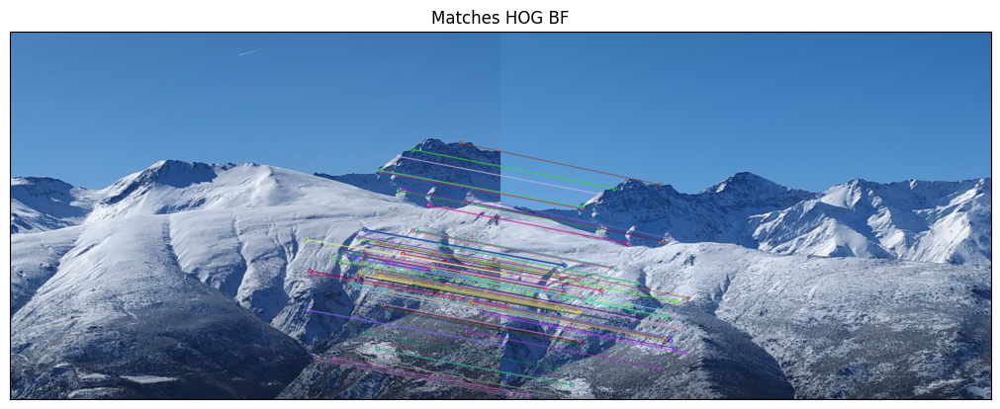

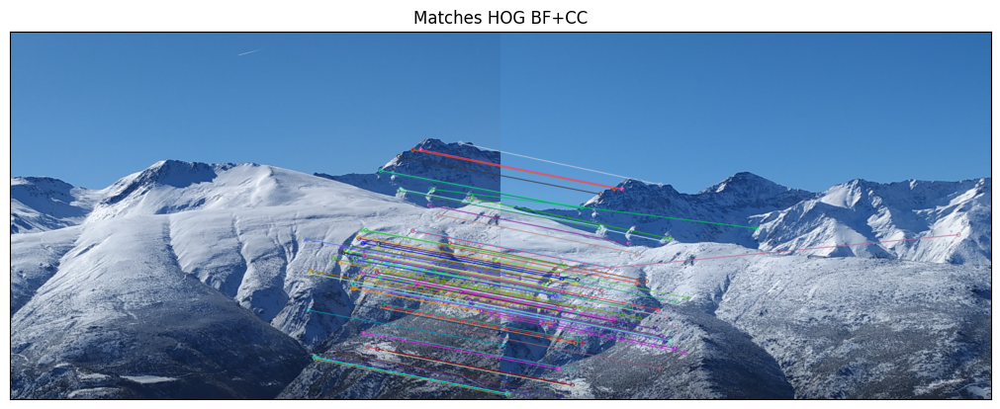

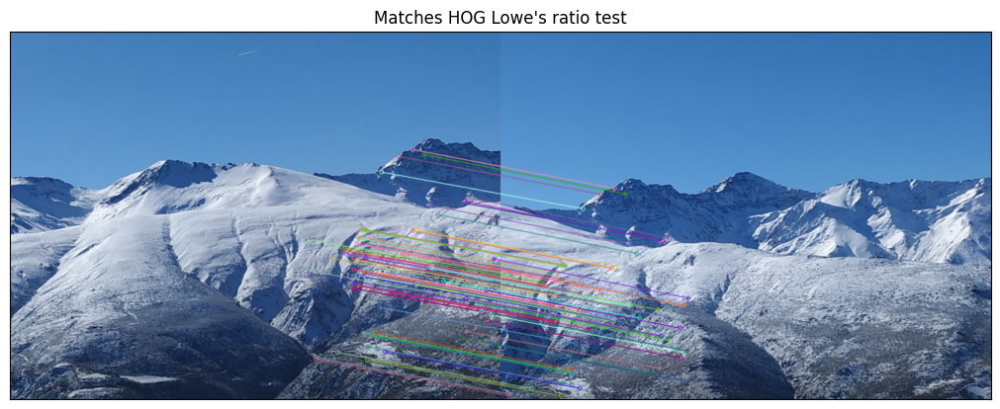

In [ ]:
showMatches(img1_color,valid_kp1,img2_color,valid_kp2,matchesBF, numberOfmatches, title='Matches HOG BF')
showMatches(img1_color,valid_kp1,img2_color,valid_kp2,matchesBFCC, numberOfmatches, title='Matches HOG BF+CC')
showMatches(img1_color,valid_kp1,img2_color,valid_kp2,matchesKNN, numberOfmatches, title='Matches HOG Lowe\'s ratio test')

Obtenemos unos matches bastante similares a los que obteníamos con SIFT. Observamos de nuevo esas rectas paralelas y descendentes que esperábamos encontrar en un buen descriptor. En este caso, al igual que en SIFT, sí parece que las líneas unen zonas similares visualmente.

De nuevo, no hay grandes diferencias entre usar un método de emparejamiento u otro. Sin embargo, es cierto que son notables 1 o 2 errores que comete el método de BF+CC, emparejando algunas zonas de la imagen izquierda con la parte derecha de la imagen derecha. Estos errores no los comete ni BF ni el test de ratio de Lowe.

<font color='blue'> ¿Cuál de los descriptores anteriores parece más adecuado para _keypoint matching_ y por qué?

Claramente la elección debería estar entre SIFT y HOG.

El emparejamiento en SIFT y HOG es prácticamente perfecto, mientras que en LBP el *matching* tiene muchos defectos, tal y como hemos ido comentando en los distintos apartados. LBP no captura información direccional y tiene descriptores poco discriminativos, ya que solo codifica un patrón binario local simple.

Entre SIFT y HOG, la diferencia es algo menor. Sin embargo, SIFT es un descriptor diseñado para ser invariante (o robusto) ante muchas transformaciones (rotación, escala, ...), lo que provoca que en la gran mayoría de casos obtenga mejores resultados en *keypoint matching* que HOG. En este caso, no se observan grandes diferencias puesto que la transformación de una imagen a otra es bastante simple.

Además, por cada keypoint, SIFT obtiene un descriptor de 128 componentes, mientras que HOG obtiene un descriptor de 3780 componentes, lo que provoca que el emparejamiento requiera una mayor cantidad de tiempo de cálculo.

Por tanto, en la gran mayoría de casos, SIFT será la mejor opción.

# <font color='blue'>**Ejercicio 3:** Creación de panoramas/mosaicos (_Image Stitching_) empleando homografías (5 puntos)

<font color='blue'>Ahora vamos a calcular homografías entre imágenes y usarlas para construir un mosaico/panorama. Para calcular la homografía entre dos imágenes, hay que llamar a la función `cv2.findHomography()`, que toma como entrada las listas de _keypoints_ y los matches/emparejamientos encontrados. Se debe usar RANSAC para realizar una estimación robusta.

Si tenemos dos imágenes de la misma superficie, tomadas desde un mismo punto de vista o tomadas desde una distancia muy grande (como es el caso), entonces existe una homografía, es decir, un cierto tipo de transformación geométrica que transforma la primera imagen en la segunda.

En primer lugar, una transformación afín es una combinación de transformaciones lineales y traslaciones. Una transformación afín está representada por una matriz 3x3 de la forma:
$$
\begin{pmatrix}
a & b & c \\
d & e & f \\
0 & 0 & 1
\end{pmatrix}
$$

Para trabajar con esta matriz, es necesario que los puntos estén en coordenadas homógeneas (es decir, con una dimensión extra sin significado geométrico).

Una generalización de las transformaciones afines son las homografías, que son matrices 3x3:
$$
\begin{pmatrix}
a & b & c \\
d & e & f \\
g & h & i
\end{pmatrix}
$$

con 8 grados de libertad (en general, se suele fijar $i$ = 1), ya que dos puntos en coordenadas homogéneas son iguales si sus coordenadas son iguales salvo un factor multiplicativo.

Por cada *match* obtenido utilizando, por ejemplo, el descriptor de SIFT, podemos determinar dos coeficientes de la matriz. Por tanto, con 4 correspondencias sería suficiente. Sin embargo, en general, vamos a tener un número de *matches* muy superior a 4.

Es aquí donde entra las técnicas de estadística robusta, RANSAC. Utilizando 4 *matches* podemos determinar una homografía, y podemos estimar lo bueno que es nuestro modelo midiendo cómo se ajustan el resto de *matches* a nuestro modelo.

Es decir, determinaremos si el resto de *matches* son inliers u outliers. Para ello, calcularemos el error entre la transformación del punto según nuestro modelo, y el punto en el que realmente debería transformarse (según el match). Si ese error es bastante reducido, concluimos que ese punto es un inlier.

El objetivo será encontrar el modelo con más inliers. RANSAC, ya implementado en la función `cv2.findHomography`, realiza un cierto número de iteraciones $T$ (por defecto, 2000), con el objetivo de que, con probabilidad $p$ (por defecto, 0.995), al menos algún conjunto aleatorio esté libre de outliers. Por defecto, el error para ser considerado outlier es de $\delta = 3$ píxeles.

In [ ]:
# this function computes a homography
def homography(kp1,kp2,matches, Ransac_Error,MIN_MATCH_COUNT=20):

  if len(matches)>MIN_MATCH_COUNT:
    # Keypoints origen de cada match (img1)
    srcPts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
    # Keypoints destino de cada match (img2)
    dstPts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

    H, mask = cv2.findHomography(srcPts, dstPts, cv2.RANSAC, Ransac_Error)
    print(f'Modelo obtenido: {np.sum(mask)/len(srcPts) * 100} % de inliers')

  else:
     print('Error - very few matches')
  return H

<font color='blue'>Para componer el mosaico necesitamos realizar los siguientes pasos:

> <font color='blue'>a) Escoger un tamaño máximo para el lienzo/canvas sobre el que vamos a pegar y "encajar" todas las imágenes (tamaño que depende del número de imágenes a unir/componer y sus dimensiones).

> <font color='blue'>b) Escoger la imagen central que dará los ejes al mosaico (que debemos escoger con criterio, de cara a mejorar la calidad final del mosaico).

> <font color='blue'>c) Establecer el orden de cada imagen respecto a la central (es decir, podemos asumir que, a priori, conocemos la posición de cada imagen en la serie de imágenes tomadas y, como consecuencia, conocemos qué imágenes están a la derecha y/o a la izquierda de otras; en otras palabras, conocemos el orden en que fueron tomadas las fotografías en el movimiento de izquierda a derecha sacando la panorámica).

> <font color='blue'>d) Calculamos la homografía para copiar la imagen central en el lienzo (que es solamente una traslación).

> <font color='blue'>e) A continuación debemos ir leyendo las imágenes de izquierda a derecha, y debemos calcular la homografía entre cada par de imágenes consecutivas.

> <font color='blue'>f) Con la información anterior, debemos componer la homografía entre cada imagen y el lienzo/canvas. Es decir, la matriz que lleva cada imagen/foto a su posición correcta en el lienzo.

> <font color='blue'>g) Ahora, debemos utilizar las homografías calculadas para transportar las imágenes al lienzo (por medio de la función `cv2.warpPerspective()`). Es importante ir de fuera hacia dentro, es decir, desde los extremos hasta el centro, pegando en último término la imagen central, que es la que presentará un menor grado de deformación.

> <font color='blue'>i) Finalmente, debemos eliminar las regiones negras de los bordes del canvas para mejorar la calidad final del mosaico.

<font color='blue'>Se debe componer el mosaico de Sierra Nevada con las imágenes `IMG_20220312_102934_S.jpg`, `IMG_20220312_102937_S.jpg`, `IMG_20220312_102940_S.jpg`, `IMG_20220312_102942_S.jpg`, `IMG_20220312_102944_S.jpg`, `IMG_20220312_102946_S.jpg`, `IMG_20220312_102948_S.jpg`, `IMG_20220312_102950_S.jpg`, `IMG_20220312_102951_S.jpg`, `IMG_20220312_102954_S.jpg`, y `IMG_20220312_102957_S.jpg`. Se recomienda operar con ellas con la mitad de resolución. Es decir, se debe hacer un resize para emplear imágenes de la mitad de filas y columnas del tamaño original.


Elegimos el tamaño del canvas (dependiendo del número de imágenes).
Se elegirá un número de filas, y se pondrán tantas como número de imágenes, y de igual forma con las columnas:

In [ ]:
# this function defines and return the canvas
def setCanvas(row,col,flagColor,nim=2):
  rows = row * nim
  cols = col * nim

  if flagColor:
    return np.zeros((rows, cols, 3), np.uint8)
  else:
    return np.zeros((rows, cols), np.uint8)

Importamos todas las imágenes:

In [ ]:
PREFIX='IMG_20220312_1029'
nameImages=['34_S.jpg','37_S.jpg','40_S.jpg','42_S.jpg','44_S.jpg','46_S.jpg','48_S.jpg','50_S.jpg','51_S.jpg','54_S.jpg','57_S.jpg']
images = []

# Resize a la mitad
for item in nameImages:
   images.append(cv2.resize(readIm(get_image(PREFIX+item),flagColor=1), (0,0), fx=0.5, fy=0.5))

Debemos ahora elegir el orden en el que se colocarán las distintas imágenes. Nuestras imágenes son el resultado de un barrido horizontal de izquierda a derecha y están ordenadas por los nombres (es decir, alfabéticamente, la primera imagen es la que está más a la izquierda, y la última será la que esté más a la derecha):

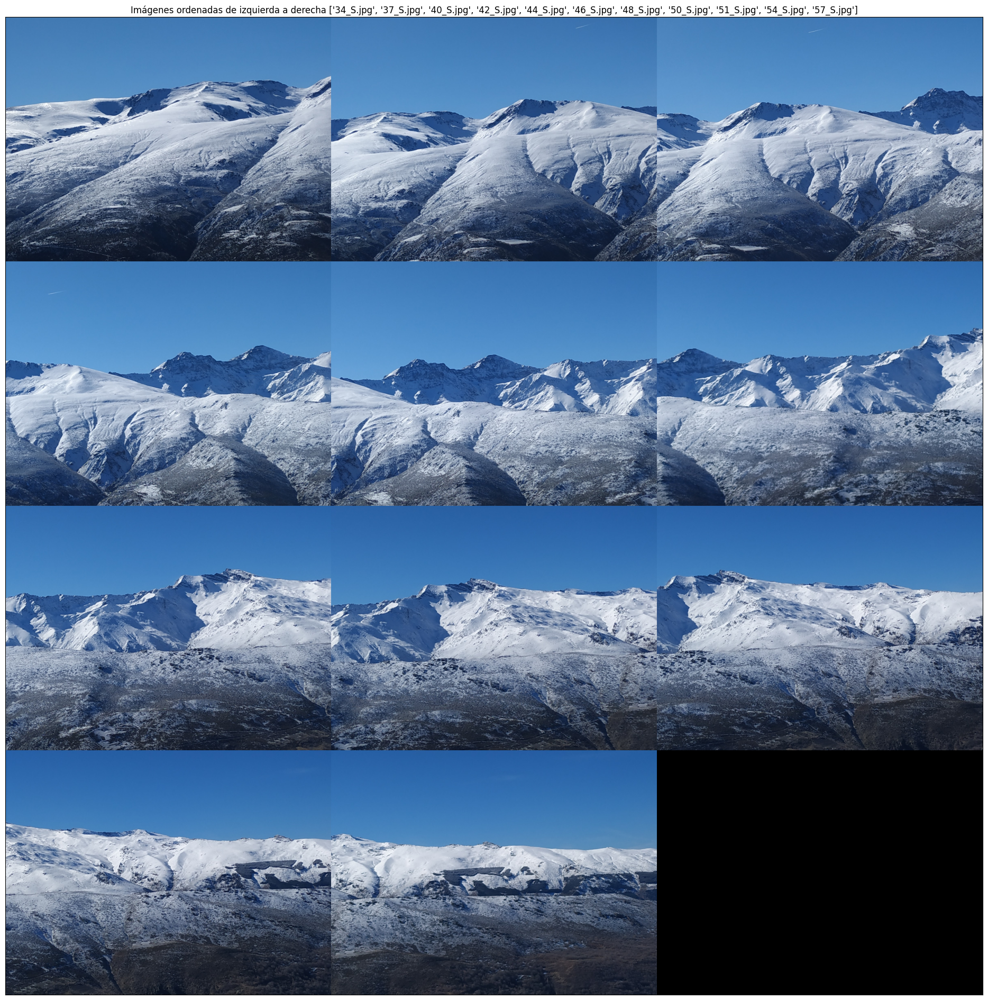

In [ ]:
displayMI_ES(images, f'Imágenes ordenadas de izquierda a derecha {nameImages}', factor = 5.0)

Debemos elegir ahora la imagen central que dará los ejes de nuestro mosaico. La transformación que se aplicará a esta imagen simplemente será una traslación $H_0$ al canvas.

Para el resto de imágenes, tendremos que calcular de alguna forma la homografía que lleva cada imagen a su posición en el canvas.

Tenemos que tener en cuenta que las homografías son deformaciones de la imagen. Por tanto, cuantas más homografías apliquemos a una imagen (mediante la composición), más deformaremos la imagen. Es por ello que debemos intentar combinar tan pocas homografías como podamos. Por tanto, debemos calcular las transformaciones de izquierda al centro y de derecha al centro; y no de izquierda a derecha.

Para las imágenes a la izquierda de la imagen central, tendremos que calcular la homografía que lleva cada imagen a su imagen inmediatamente a la derecha. Podremos finalmente ir componiendo estas homografías hasta llegar a la imagen central, y por último componer con $H_0$, que nos llevará la imagen a su posición en el canvas.

Para las imágenes a la derecha de la imagen central, el proceso sería análogo, calculando las homografías que lleva cada imagen a su imagen inmediatamente a la izquierda.

Debemos elegir ahora la imagen central. No debemos pensar que la imagen central va a ser siempre la mediana de las imágenes que tenemos.

Si se toman muchas fotografías de la zona de la izquierda y muy pocas de la zona de la derecha, y eligiéramos como imagen la imagen de la mediana, nos quedaría muy distorsionada la zona de la derecha.

Por tanto, esta elección va a depender de cómo estén tomadas las fotografías. Deberemos tomar una imagen central, de manera que a la izquierda y a la derecha las zonas estén igualmente representadas.

A pesar de ello, en este caso, parece que las 13 imágenes están tomadas de forma bastante uniforme (mirando de izquierda a derecha, en todas las imágenes se observa una ligera traslación hacia la derecha, muy similar en todos los casos) por lo que sí elegiremos como imagen central la imagen mediana:

In [59]:
# ELEGIMOS LA IMAGEN CENTRAL
idx = len(images) // 2
center_image = images[idx]

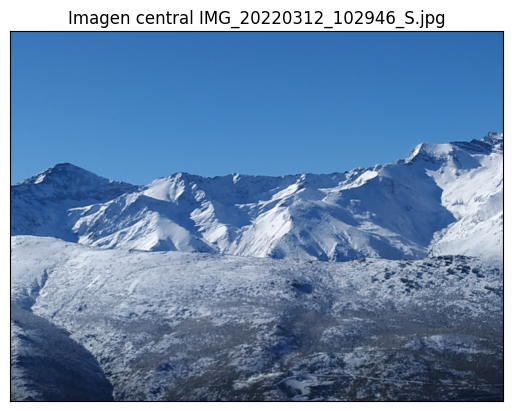

In [60]:
displayIm(center_image, f'Imagen central {PREFIX + nameImages[idx]}', 1)

Definimos la homografía para copiar la imagen central en el lienzo (que es solamente una traslación).

In [61]:
# this function fixes the homography from the central image to the canvas
def axesHomography(sizeim,sizecanvas):

  # Matriz identidad 3x3
  H=np.eye(3)

  # Traslación para ajustar al centro del canvas
  # sizecanvas = (alto, ancho)
  # sizeim     = (alto, ancho)
  H[0,2]=sizecanvas[1]//2-sizeim[1]//2
  H[1,2]=sizecanvas[0]//2-sizeim[0]//2

  return H

Definimos ahora la función para calcular la homografía entre dos imágenes consecutivas. Para facilitar el proceso, calcularemos la homografía que lleva cada imagen a su imagen inmediatamente a la derecha. Posteriormente, tendremos que invertir las homografías a la derecha de la imagen central.

Para calcular los keypoints y los descriptores entre las imágenes para realizar el proceso de *matching* utilizaremos SIFT. Es el método que mejores resultados nos dio en el ejercicio 2, y el más robusto en general.

En cuanto al método de *matching* utilizaremos el que teóricamente da mejores resultados, que es el ratio test de Lowe (KNN con k=2). Utilizaremos la misma implementación que en el ejercicio anterior (con parámetro 0.75).

En cuanto al error de RANSAC a elegir, debería ser un valor bastante reducido, pero permitiendo cierto error (por el ruido de la imagen y porque el *matching* tendrá un ligero error, es prácticamente imposible que un punto tenga error 0). El valor por defecto (3 píxeles), o incluso 5 píxeles, parecen valores bastante adecuados; ya que permiten algo error, pero en general no será muy perceptible a simple vista:



In [62]:
# this function computes the homographies between each two consecutive images
def computeLocalHomographies(images,method='KNN', Ransac_Error=5.0):
  H = []

  # Calculamos los keypoints y descriptores en escala de grises
  images_gray = [cv2.cvtColor(img,cv2.COLOR_RGB2GRAY) for img in images]

  for i in range(len(images_gray)-1):
    kp1, ds1 = siftPoints(images_gray[i])
    kp2, ds2 = siftPoints(images_gray[i+1])

    matches = matching(ds1,ds2,method)
    H.append(homography(kp1,kp2,matches, Ransac_Error))

  return H

Definimos ahora la función que calcula, realizando la composición de homografías, la homografía que lleva cada imagen al canvas.

En primer lugar, invertimos las homografías a la derecha de la imagen central (para ir desde esas imágenes hacia la imagen central).

Componemos las homografías a la izquierda de la imagen central. Supongamos que *idx* es la posición de la imagen central. Utilizando la anterior función `computeLocalHomographies`, en $\textbf{H[idx-1]}$, tenemos la homografía que transforma la $\textbf{imagen[idx-1]}$ al sist. de coords. de la imagen central.

Para calcular la homografía que lleva $\textbf{imagen[idx-2]}$ al sist. de coords. de la imagen central, simplemente tenemos que componer $\textbf{H[idx-2]}$ con $\textbf{H[idx-1]}$ (utilizando simplemente una multiplicación de matrices). Para calcular la homografía que lleva $\textbf{imagen[idx-3]}$ al sist. de coords. de la imagen central, simplemente tenemos que componer $\textbf{H[idx-3]}$ con $\textbf{H[idx-2]}$.
  
Repetimos este proceso hasta llegar a la primera imagen. Es importante el orden en el que hay que realizar la composición. La transformación se realiza de izquierda a derecha, es decir, primero queremos que un punto se transforme mediante $\textbf{H[i]}$ y después mediante $\textbf{H[i+1]}$. Como los puntos se transforman multiplicando por la derecha, es decir:

$$
\begin{pmatrix} x_2 \\ y_2 \\ z_2 \end{pmatrix} =
\begin{pmatrix}
h_{11} & h_{12} & h_{13} \\
h_{21} & h_{22} & h_{23} \\
h_{31} & h_{32} & h_{33} \\
\end{pmatrix}
\begin{pmatrix} x_1 \\ y_1 \\ z_1 \end{pmatrix}
$$

, tendremos que hacerlo de la forma:

$$
\begin{pmatrix} x_2 \\ y_2 \\ z_2 \end{pmatrix} = H[i+1] H[i] \begin{pmatrix} x_1 \\ y_1 \\ z_1 \end{pmatrix}
$$

En segundo lugar, componemos las homografías a la derecha de la imagen central. Supongamos que *idx* es la posición de la imagen central. Utilizando la anterior función `computeLocalHomographies` y la inversión que hemos realizado, en $\textbf{H[idx]}$, tenemos la homografía que transforma la $\textbf{imagen[idx+1]}$ al sist. de coords. de la imagen central.

Para calcular la homografía que lleva $\textbf{imagen[idx+2]}$ al sist. de coords. de la imagen central, simplemente tenemos que componer $\textbf{H[idx+1]}$ con $\textbf{H[idx]}$ (utilizando simplemente una multiplicación de matrices). Para calcular la homografía que lleva $\textbf{imagen[idx+3]}$ al sist. de coords. de la imagen central, simplemente tenemos que componer $\textbf{H[idx+2]}$ con $\textbf{H[idx+1]}$ .
  
Repetimos este proceso hasta llegar a la última imagen. Es importante el orden en el que hay que realizar la composición. La transformación se realiza de derecha a izquierda, es decir, primero queremos que el punto se transforme mediante $\textbf{H[i]}$ y después mediante $\textbf{H[i-1]}$. Por tanto:

$$
\begin{pmatrix} x_2 \\ y_2 \\ z_2 \end{pmatrix} = H[i-1] H[i] \begin{pmatrix} x_1 \\ y_1 \\ z_1 \end{pmatrix}
$$

In [63]:
# this function computes the homography from each image to the center image system coordinates
# idx in this case is the index of the central image
def mosaicHomographies(H,idx):

  # Invertimos las homografías a la derecha de la imagen central
  for i in range(idx,len(H)):
    H[i] = np.linalg.inv(H[i])

  # Composición de homografías para imágenes a la izquierda
  for i in range(idx-2,-1,-1):
    H[i] = H[i+1] @ H[i]

  # Composición de homografías para imágenes a la derecha
  for i in range(idx+1,len(H)):
    H[i] = H[i-1] @ H[i]


  return H

Aplicamos la homografía a cada imagen, llevando cada imagen al canvas con la deformación necesaria.

Para que el acabado de nuestro mosaico sea mejor, deberán quedar por encima las imágenes con menor deformación, es decir, las imágenes más cercanas al centro. Por ello, iremos de fuera hacia dentro, es decir, pegaremos primero las imágenes de los extremos, y posteriormente las imágenes más cercanas al centro, de manera que serán las imágenes que quedarán por encima.

Por último, pegaremos la imagen del centro, que es la imagen que no tiene ninguna deformación, y por tanto, debe quedar por encima de todas las demás:

In [64]:
# This function composes the mosaic. It receives:
# * images: the list of images
# * canvas: the canvas, generated through the application of setCanvas()
# * H: the list of homographies, obtained through the application of
# computeLocalHomographies() and mosaicHomographies()
# * idx: the index of the central image
# * H0: the homography that represents the translation from the central image to the
# canvas obtained through the application of axesHomography()
def composeMosaic(images,canvas,H,idx,H0, showSteps = False):

  rows = canvas.shape[0]
  cols = canvas.shape[1]

  for i in range(idx):
    canvas = cv2.warpPerspective(images[i],H0 @ H[i],(cols,rows), dst=canvas, flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_TRANSPARENT)
    if (showSteps):
      displayIm(canvas, 1)

  for i in range(len(images)-1, idx, -1):
    canvas = cv2.warpPerspective(images[i],H0 @ H[i-1],(cols,rows), dst=canvas, flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_TRANSPARENT)
    if (showSteps):
      displayIm(canvas, 1)

  canvas = cv2.warpPerspective(images[idx],H0,(cols,rows), dst=canvas, flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_TRANSPARENT)

  return canvas

Calculamos ya la primera versión de nuestro mosaico:

In [65]:
# Apartado a)
rows = images[0].shape[0]
cols = images[0].shape[1]
canvas = setCanvas(rows,cols,flagColor=True, nim=len(images))

# Apartado b)
idx = len(images) // 2

# Apartado d)
H0 = axesHomography(images[idx][:2].shape, canvas.shape)

# Apartado e)
H = computeLocalHomographies(images)

Modelo obtenido: 99.32546374367622 % de inliers
Modelo obtenido: 99.40119760479041 % de inliers
Modelo obtenido: 99.46595460614152 % de inliers
Modelo obtenido: 99.20828258221681 % de inliers
Modelo obtenido: 99.23611111111111 % de inliers
Modelo obtenido: 99.1313789359392 % de inliers
Modelo obtenido: 99.64028776978418 % de inliers
Modelo obtenido: 99.55156950672645 % de inliers
Modelo obtenido: 99.55703211517165 % de inliers
Modelo obtenido: 98.28571428571429 % de inliers


Observamos que las homografías obtenidas mediante RANSAC tienen muy buena calidad alcanzando, salvo en un caso, más del 99% de inliers respecto del total de matches.

Pintamos ya el mosaico:

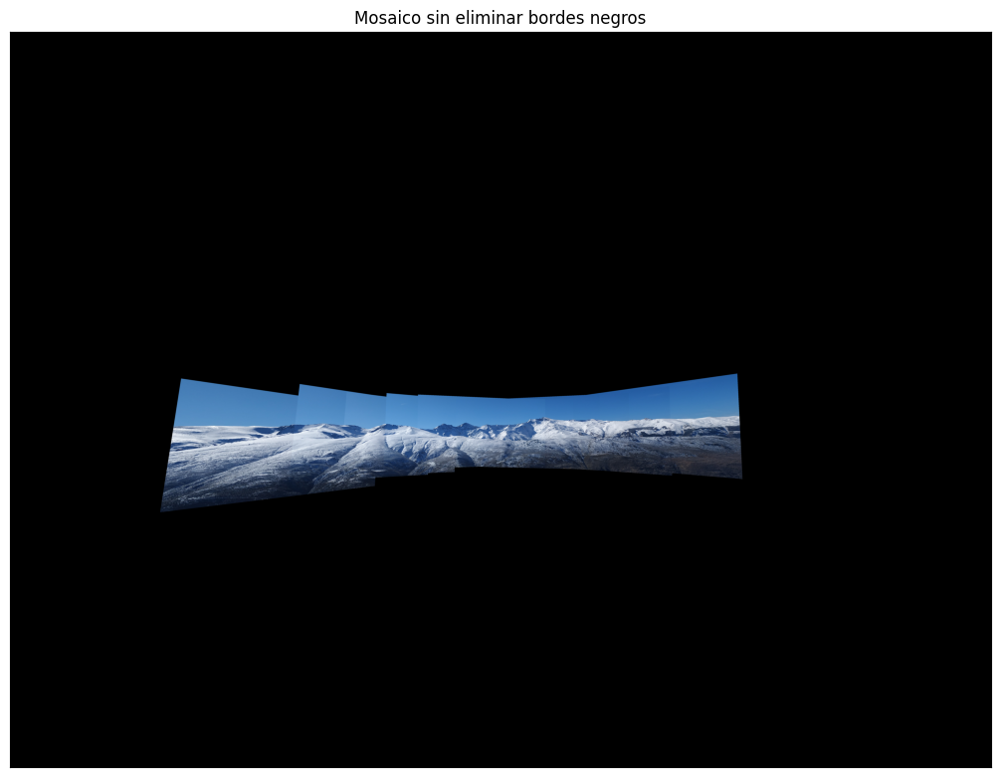

In [66]:
# Apartado f) y g)
H = mosaicHomographies(H,idx)
mosaic = composeMosaic(images,canvas,H,idx,H0)
displayIm(mosaic, 'Mosaico sin eliminar bordes negros')

Para mejorar la calidad de nuestro mosaico, eliminaremos las regiones negras de los bordes del canvas, utilizando la función:

In [67]:
# This function removes the redundant pixels from the canvas
def blackOut(img, offset=0):
  if len(img.shape)==3:
    im =cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    mask = np.array((im > 0), np.uint8)
    x,y,w,h=cv2.boundingRect(mask)
    return img[y+offset:y+h-offset,x+offset:x+w-offset,:]
  else:
    mask = np.array((img > 0), np.uint8)
    x,y,w,h=cv2.boundingRect(mask)
    return img[y+offset:y+h-offset,x+offset:x+w-offset]

In [68]:
# This function composes the mosaic. It receives:
# * images: the list of images
# * canvas: the canvas, generated through the application of setCanvas()
# * H: the list of homographies, obtained through the application of
# computeLocalHomographies() and mosaicHomographies()
# * idx: the index of the central image
# * H0: the homography that represents the translation from the central image to the
# canvas obtained through the application of axesHomography()
def composeMosaic(images,canvas,H,idx,H0, showSteps = False):

  rows = canvas.shape[0]
  cols = canvas.shape[1]

  for i in range(idx):
    canvas = cv2.warpPerspective(images[i],H0 @ H[i],(cols,rows), dst=canvas, flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_TRANSPARENT)
    if (showSteps):
      displayIm(blackOut(canvas), title=f'Añadida imagen {i}')

  for i in range(len(images)-1, idx, -1):
    canvas = cv2.warpPerspective(images[i],H0 @ H[i-1],(cols,rows), dst=canvas, flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_TRANSPARENT)
    if (showSteps):
      displayIm(blackOut(canvas), title=f'Añadida imagen {i}')

  canvas = cv2.warpPerspective(images[idx],H0,(cols,rows), dst=canvas, flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_TRANSPARENT)
  if (showSteps):
    displayIm(blackOut(canvas), title=f'Añadida imagen central (imagen {idx})', factor = 3.0)

  return blackOut(canvas)

Creamos ahora nuestro mosaico definitivo. Mostraremos todo el proceso de creación (cada vez que que pegamos una imagen):

In [69]:
# Apartado a)
rows = images[0].shape[0]
cols = images[0].shape[1]
canvas = setCanvas(rows,cols,flagColor=True, nim=len(images))

# Apartado b)
idx = len(images) // 2

# Apartado d)
H0 = axesHomography(images[idx][:2].shape, canvas.shape)

# Apartado e)
H = computeLocalHomographies(images)

Modelo obtenido: 99.32546374367622 % de inliers
Modelo obtenido: 99.40119760479041 % de inliers
Modelo obtenido: 99.46595460614152 % de inliers
Modelo obtenido: 99.20828258221681 % de inliers
Modelo obtenido: 99.23611111111111 % de inliers
Modelo obtenido: 99.1313789359392 % de inliers
Modelo obtenido: 99.64028776978418 % de inliers
Modelo obtenido: 99.55156950672645 % de inliers
Modelo obtenido: 99.55703211517165 % de inliers
Modelo obtenido: 98.28571428571429 % de inliers


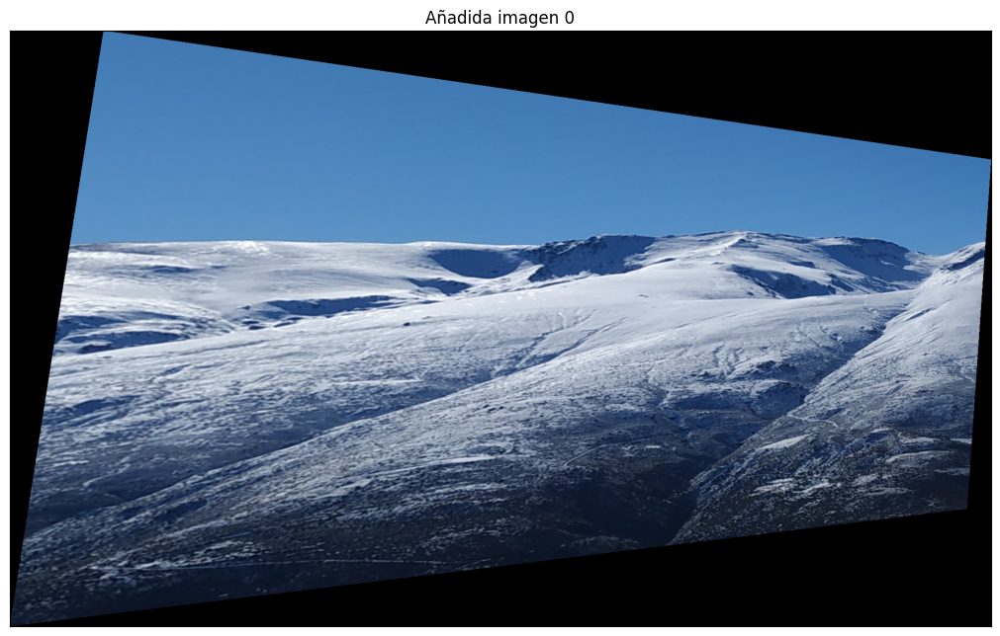

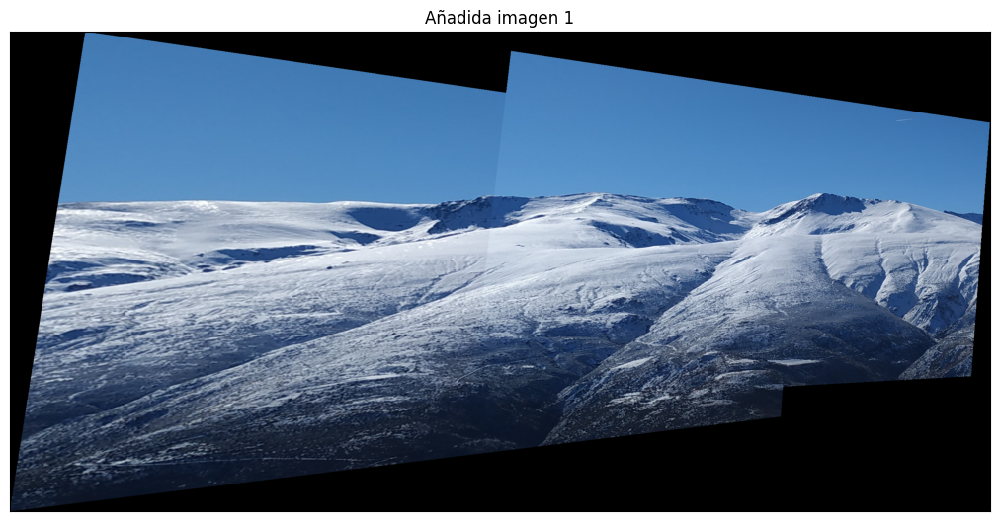

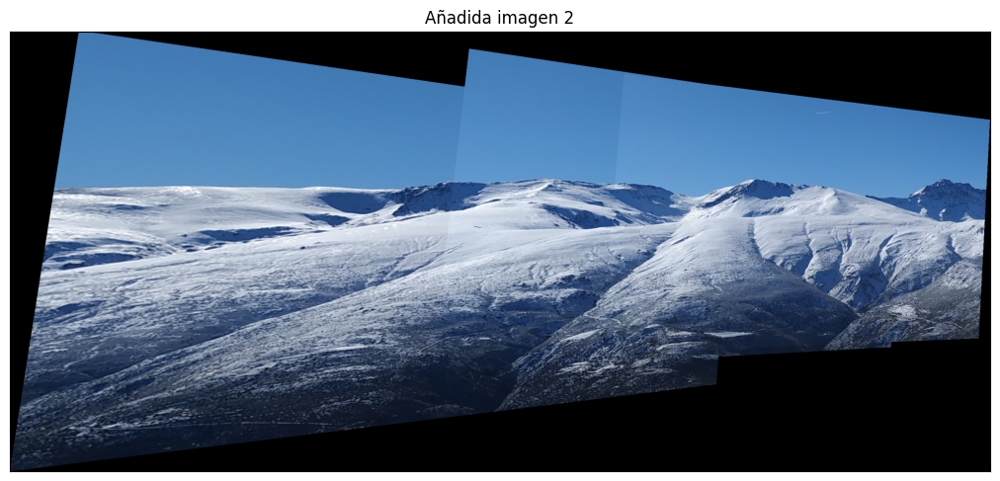

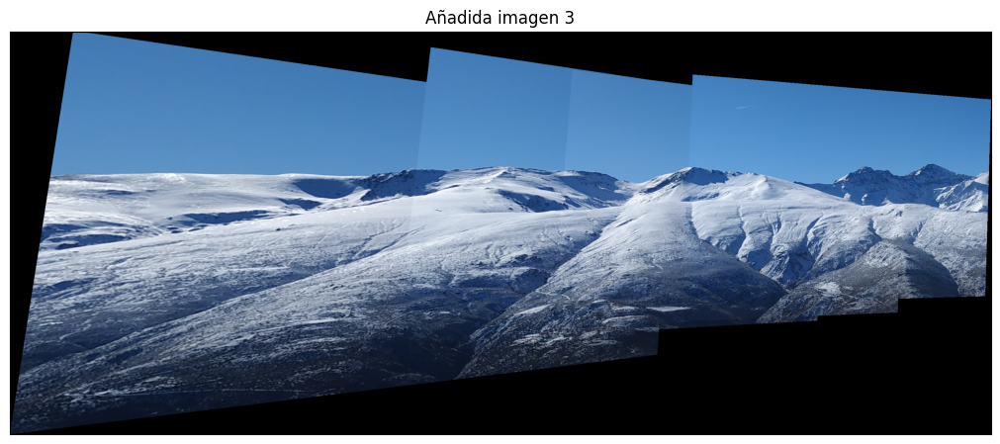

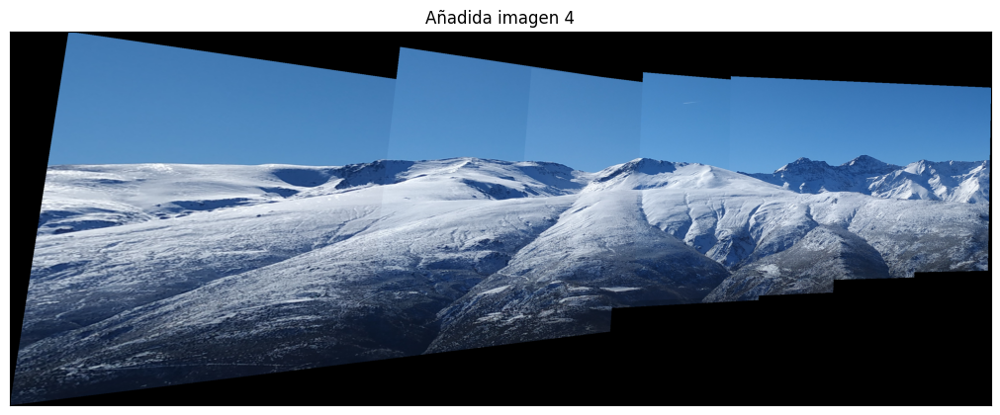

...

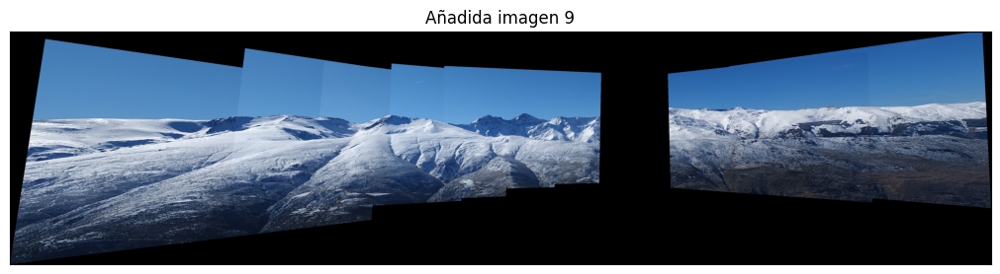

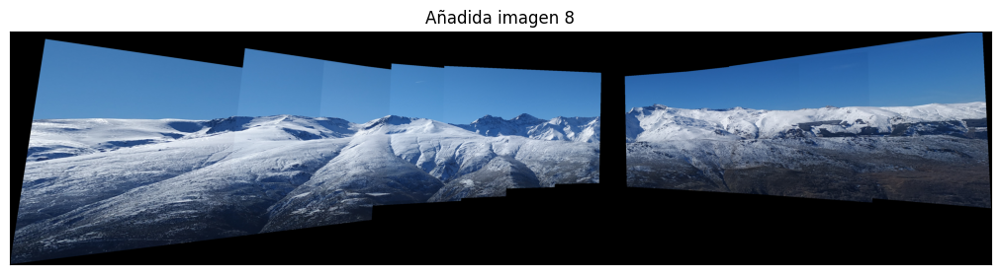

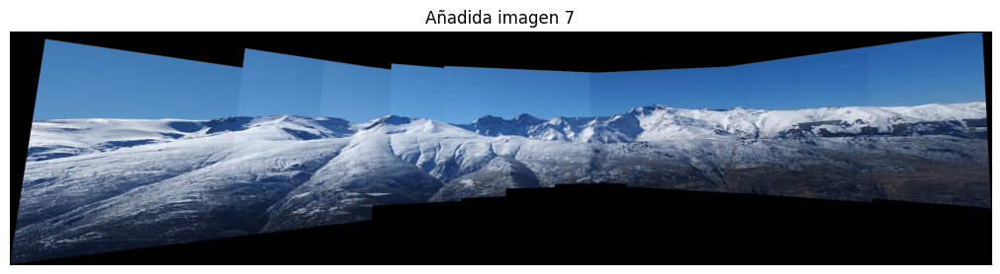

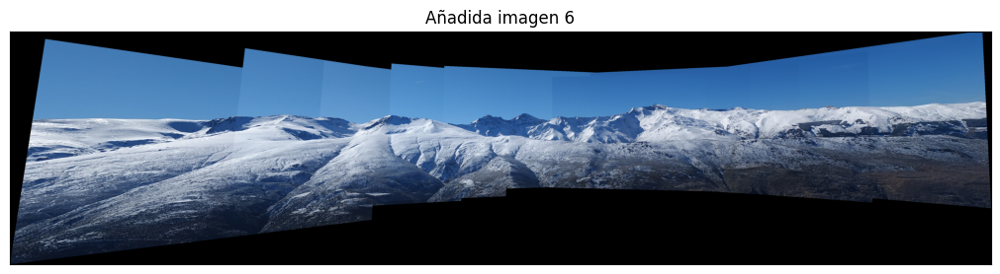

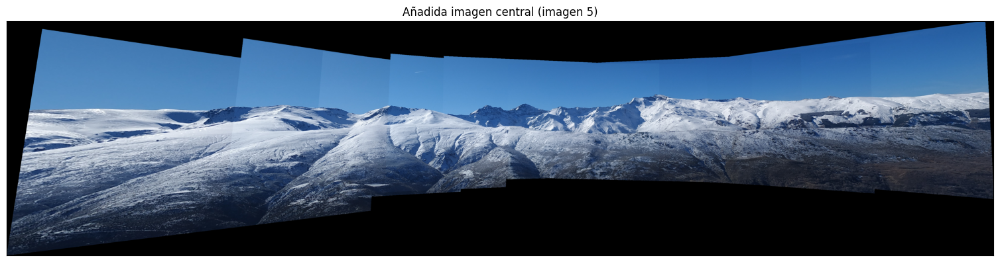

In [70]:
# Apartado f) y g)
H = mosaicHomographies(H,idx)
mosaic = composeMosaic(images,canvas,H,idx,H0, showSteps=True)

Y observamos que el resultado es bastante bueno.

Observamos que existe una deformación mayor en la zona de la izquierda, por lo que parece que podría elegirse como imagen central la quinta imagen, en lugar de la sexta. Esto parece indicar que de la zona de la izquierda hay más imágenes que de la parte de la derecha. Veamos que el resultado mejora:

In [71]:
# Apartado a)
rows = images[0].shape[0]
cols = images[0].shape[1]
canvas = setCanvas(rows,cols,flagColor=True, nim=len(images))

# Apartado b)
idx = len(images) // 2 - 1

# Apartado d)
H0 = axesHomography(images[idx][:2].shape, canvas.shape)

# Apartado e)
H = computeLocalHomographies(images)

Modelo obtenido: 99.32546374367622 % de inliers
Modelo obtenido: 99.40119760479041 % de inliers
Modelo obtenido: 99.46595460614152 % de inliers
Modelo obtenido: 99.20828258221681 % de inliers
Modelo obtenido: 99.23611111111111 % de inliers
Modelo obtenido: 99.1313789359392 % de inliers
Modelo obtenido: 99.64028776978418 % de inliers
Modelo obtenido: 99.55156950672645 % de inliers
Modelo obtenido: 99.55703211517165 % de inliers
Modelo obtenido: 98.28571428571429 % de inliers


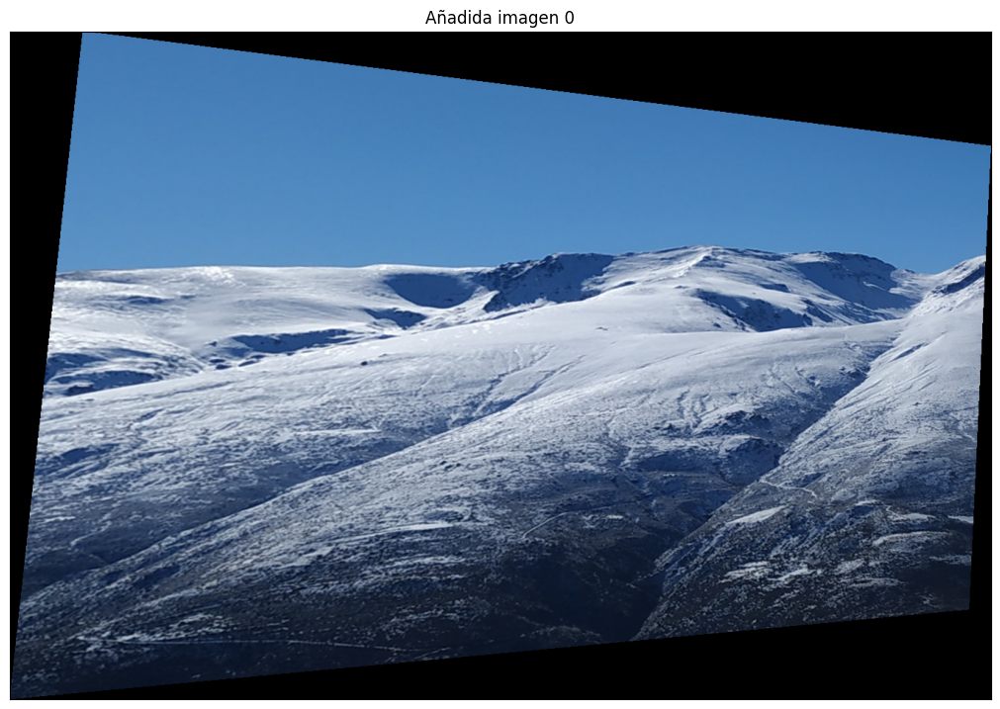

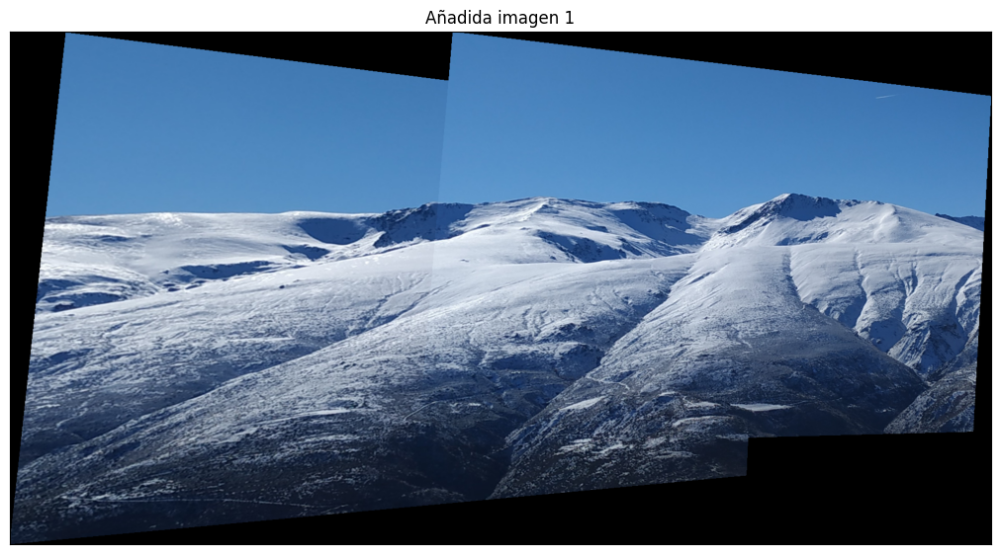

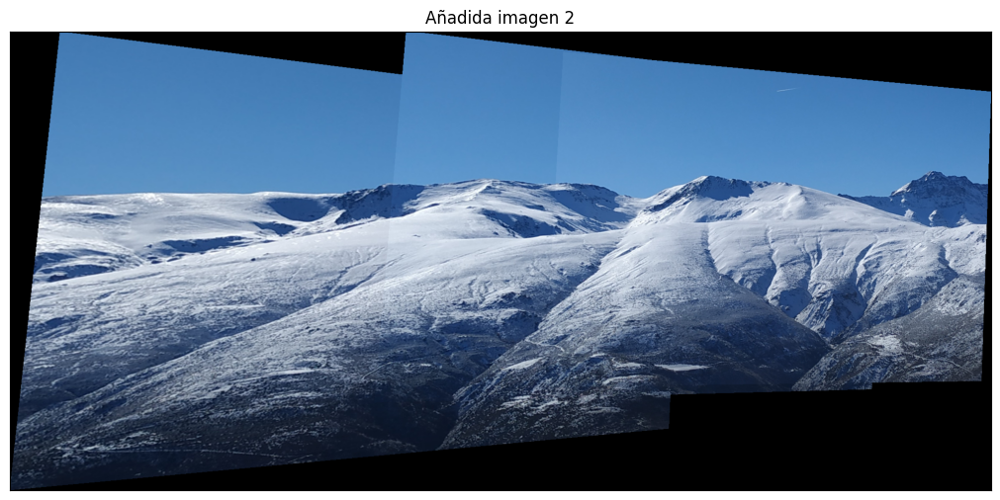

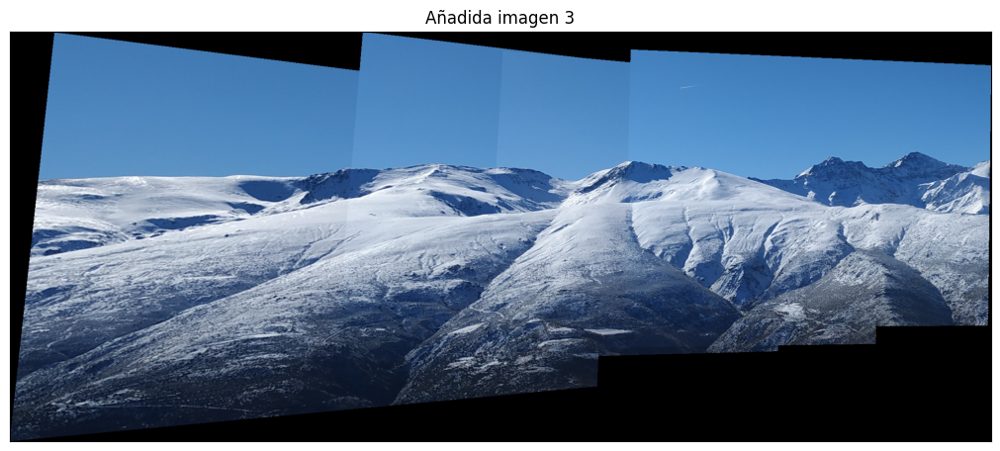

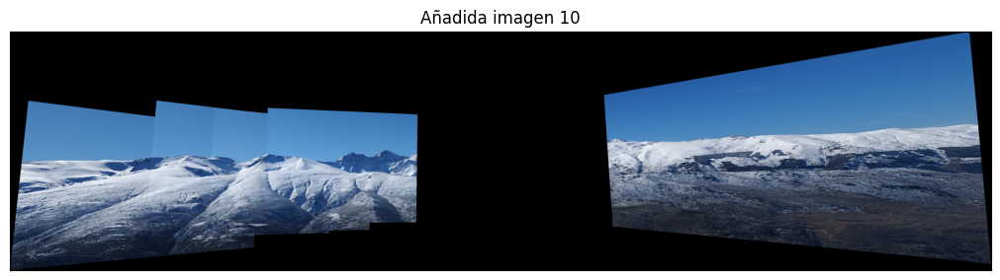

...

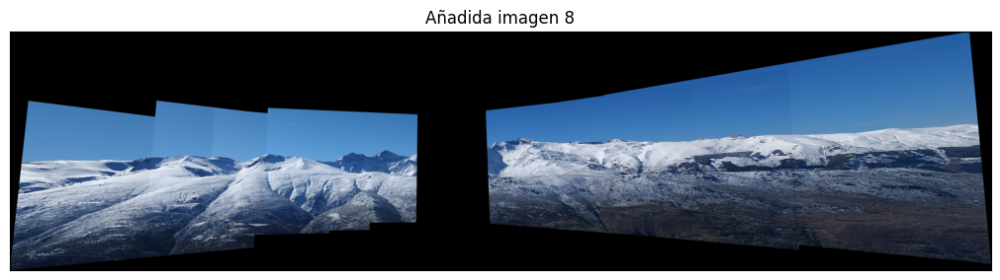

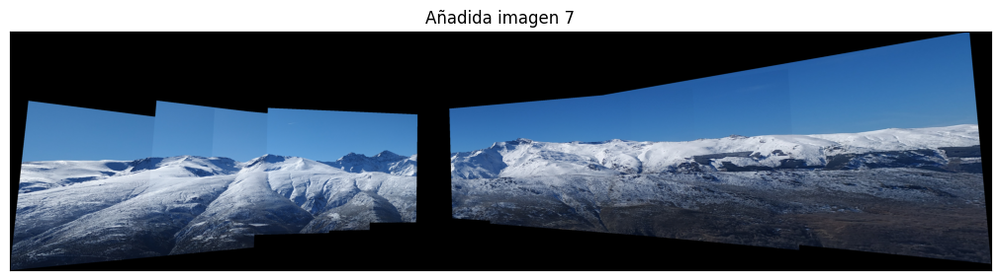

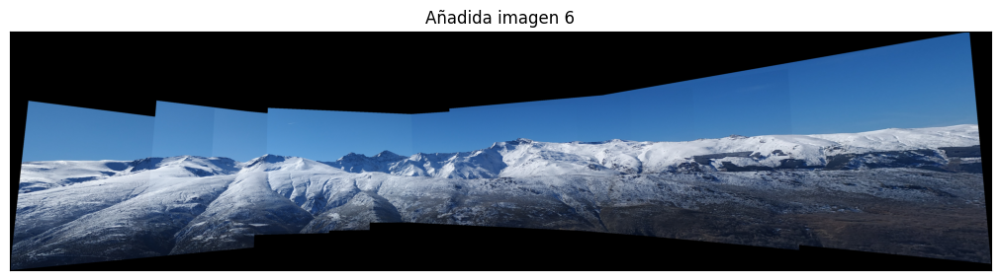

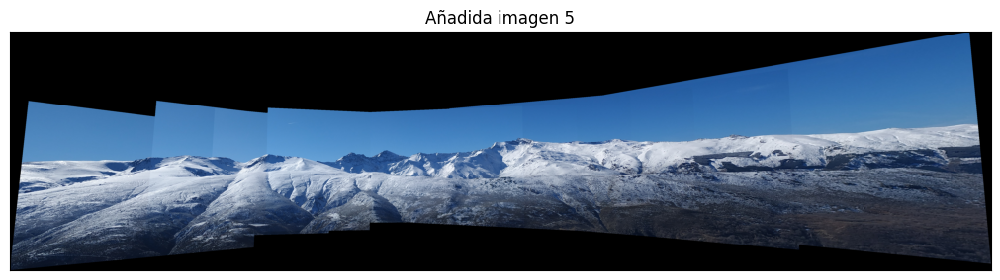

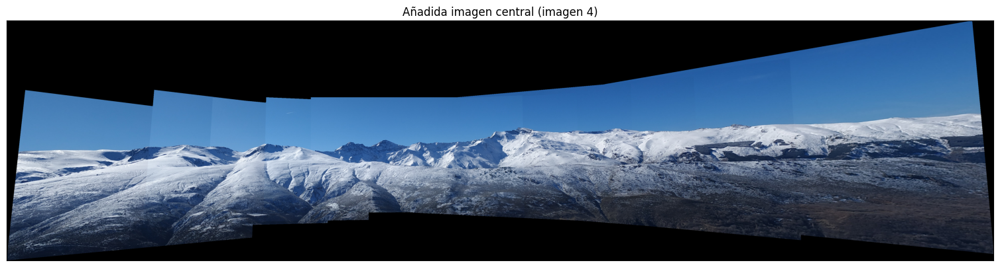

In [72]:
# Apartado f) y g)
H = mosaicHomographies(H,idx)
mosaic = composeMosaic(images,canvas,H,idx,H0, showSteps=True)

El resultado es aun mejor, especialmente en la zona de la izquierda de la imagen, donde se reduce bastante la deformación respecto al caso anterior. Además, en la zona derecha no aumenta mucho la deformación, por lo que nos podemos quedar con esta versión.

El resultado es bastante llamativo. Partiendo de imágenes individuales de Sierra Nevada, se ha podido reconstruir una imagen completa de la sierra, proceso que hubiera sido bastante complicado de realizar manualmente.

También el ejercicio muestra el buen funcionamiento de SIFT, que como veíamos en el ejercicio anterior, obtiene unos matches prácticamente perfectos, lo que conlleva (junto con RANSAC) que las homografías sean prácticamente perfectas (> 99% de inliers en casi todos los casos).

Por pura curiosidad, podemos también comprobar que ocurre si se elige de forma (muy) incorrecta la imagen central:

In [73]:
# Apartado a)
rows = images[0].shape[0]
cols = images[0].shape[1]
canvas = setCanvas(rows,cols,flagColor=True, nim=len(images))

# Apartado b)
idx = len(images) - 1

# Apartado d)
H0 = axesHomography(images[idx][:2].shape, canvas.shape)

# Apartado e)
H = computeLocalHomographies(images)

Modelo obtenido: 99.32546374367622 % de inliers
Modelo obtenido: 99.40119760479041 % de inliers
Modelo obtenido: 99.46595460614152 % de inliers
Modelo obtenido: 99.20828258221681 % de inliers
Modelo obtenido: 99.23611111111111 % de inliers
Modelo obtenido: 99.1313789359392 % de inliers
Modelo obtenido: 99.64028776978418 % de inliers
Modelo obtenido: 99.55156950672645 % de inliers
Modelo obtenido: 99.55703211517165 % de inliers
Modelo obtenido: 98.28571428571429 % de inliers


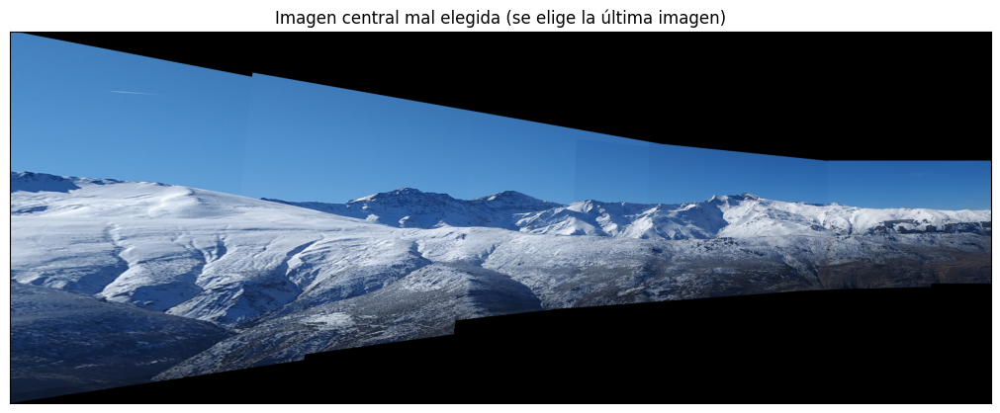

In [74]:
# Apartado f) y g)
H = mosaicHomographies(H,idx)
mosaic = composeMosaic(images,canvas,H,idx,H0)
displayIm(mosaic, title = 'Imagen central mal elegida (se elige la última imagen)')

Observamos que a la izquierda se obtiene una deformación enorme. De hecho, se realizan 10 homografías (+ la traslación) para colocar la primera imagen, mientras que en nuestro caso realizábamos como máximo 6 homografías (para colocar la última imagen).

<font color='blue'>Se debe mostrar la composición, paso a paso, del canvas, es decir, el canvas a medida que se le van incorporando cada una de las imágenes, así como la composición final del mosaico. Finalmente, se debe comparar el resultado de nuestra composición manual con el _stitcher_ de OpenCV: `cv2.Stitcher`.

<font color='blue'>Al igual que en todas las demás entregas y ejercicios, resulta fundamental documentar el trabajo realizado, y explicar pausadamente todas las etapas implementadas (qué se ha hecho, cómo se ha hecho, y por qué se ha hecho así).

Finalmente, comparamos el resultado con `cv2.Stitcher`:

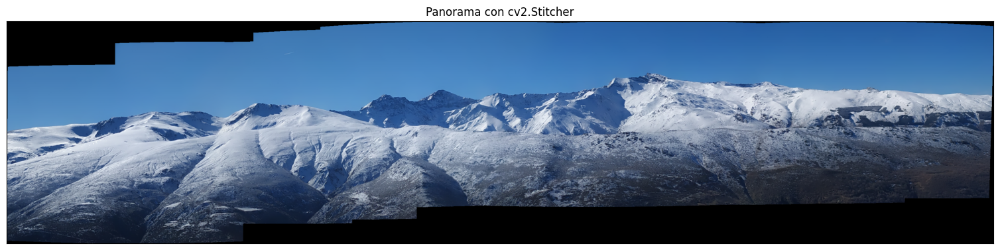

In [75]:
# Crear el objeto Stitcher
stitcher = cv2.Stitcher_create()

# Unir las imágenes
(status, panorama) = stitcher.stitch(images)

displayIm(panorama, title='Panorama con cv2.Stitcher', factor=3.0)

Comprobamos que el resultado que se obtiene es bastante mejor que el nuestro. Ni por la izquierda ni por la derecha se observa ninguna deformación aparente. Además, los cambios en la iluminación que apreciábamos en nuestro panorama aquí no se observan.

Veamos a qué se deben estas diferencias utilizando la documentación de OpenCV [[6]](https://docs.opencv.org/4.x/d2/d8d/classcv_1_1Stitcher.html#details) [[7]](https://docs.opencv.org/4.x/d1/d46/group__stitching.html).

En cuanto a la iluminación, `Stitcher` realiza varios procesos que suavizan el pegado de las imágenes. En un principio, realiza una compensación de la exposición (cantidad de luz que entra en el sensor de la cámara al realizar la fotografía), para que todas las imágenes tengan una iluminación similar. Posteriormente, realiza un proceso de blending (muy similar al realizado en la práctica 1) para que no se observen prácticamente diferencias al combinar las imágenes.

Para corregir las distorsiones en los extremos de la imagen, `Stitcher` proyecta, por defecto, la imagen en una esfera "`projects resulting panorama to sphere`", en lugar de en un canvas plano como nosotros estamos realizando (también permite utilizar p.ej. proyecciones cilíndricas o cónicas). Esto, especialmente en campos visuales bastante amplios, como es el caso, provoca que exista una menor deformación en los extremos.